In [1]:
## This notebook is a test environment for automatically indexing the drone data into grids and passes... 

## First, import general packages for running python analysis:
import os
import numpy as np
from matplotlib.pyplot import *
import h5py
import datetime
import pytz

## Then, import the beamcals module packages and initialize 'gbosite' class:
from beamcals import corr
from beamcals import concat
from beamcals import drone
from beamcals import bicolog
import beamcals.plotting_utils as pu
import beamcals.fitting_utils as fu
import beamcals.geometry_utils as gu
import beamcals.time_utils as tu
from beamcals.sites import site
gbosite=site.site('../beamcals/beamcals/sites/GBO_config.npz')

Initializing Correlator Class using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> Arrays initialized with shape (124, 256, 1024, 16)
Assigning array values by reading in data files:
 --> Loading File: 0123/0123Initializing drone data via datcon_csv routine: FLY533.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK data contains 13308/13308 non-nan values
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29304 elements
  --> drone timestamp axis contains 13308 elements
Maximum Pearson_R Correlations:
  --> t_ind

/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:204: RuntimeWarning: Mean of empty slice
  self.V_bg[k,:,:]=np.nanmean(self.V[t_window,:,:],axis=0)


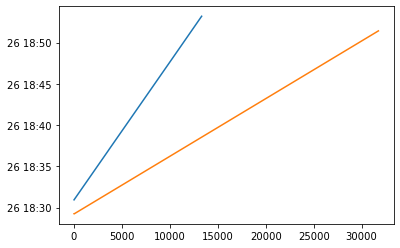

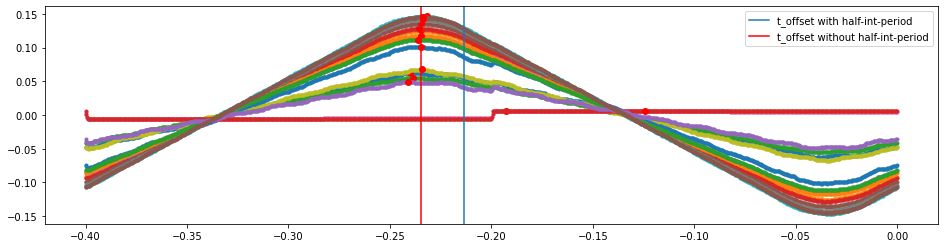

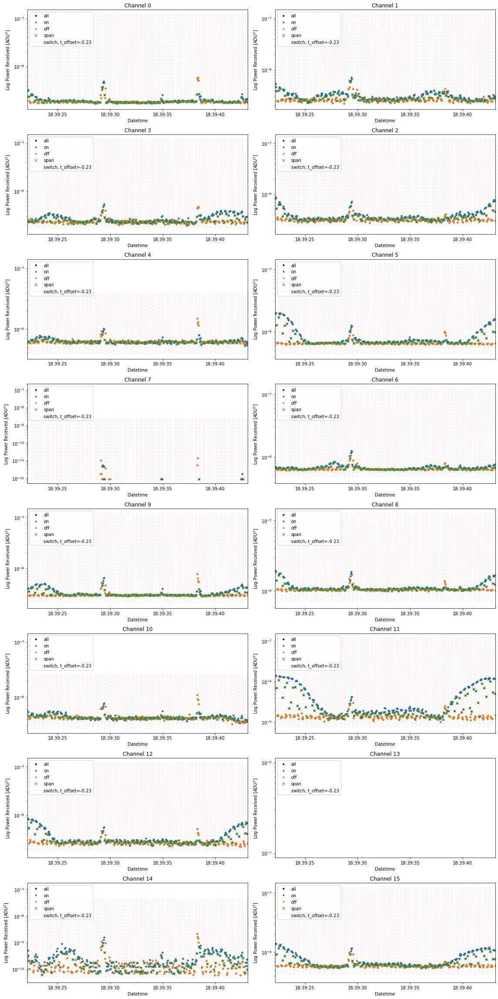

In [2]:
## 1) 0825 -- Flight from 20210826T185621: Comments only include "Large Grid 3"

## Read in the Corr_Data class:
datadir='/hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/'
gaindir='/hirax/GBO_Aug_2021/TONE_ACQ/digital_gains/20210826T182904Z_yale_drone_yale_digitalgain/'
corrtest0825=corr.Corr_Data(Data_Directory=datadir,Gain_Directory=gaindir,site_class=gbosite)

## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest0825=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY533.csv',site_class=gbosite)

## Since we know the data are from the same time we can combine them with the Concat_Class:
plot(dronetest0825.t_arr_datetime)
plot(corrtest0825.t_arr_datetime)
concattest0825=concat.CONCAT(CORRDATCLASS=corrtest0825,DRONEDATCLASS=dronetest0825)

## Use the Extract_Source_Pulses and Perform_Background_Subtraction functions:
concattest0825.Extract_Source_Pulses(Period=0.4e6,Dutycycle=0.2e6,t_bounds=[14500,15000])
concattest0825.Perform_Background_Subtraction()

Applied offset is 1.426062 seconds


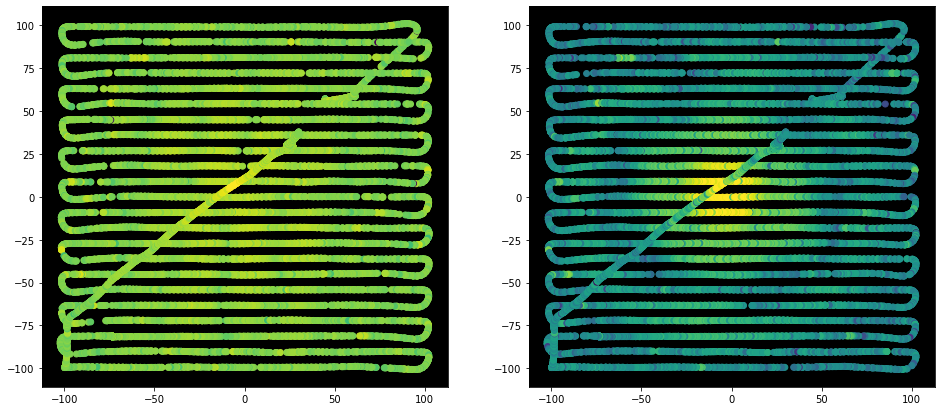

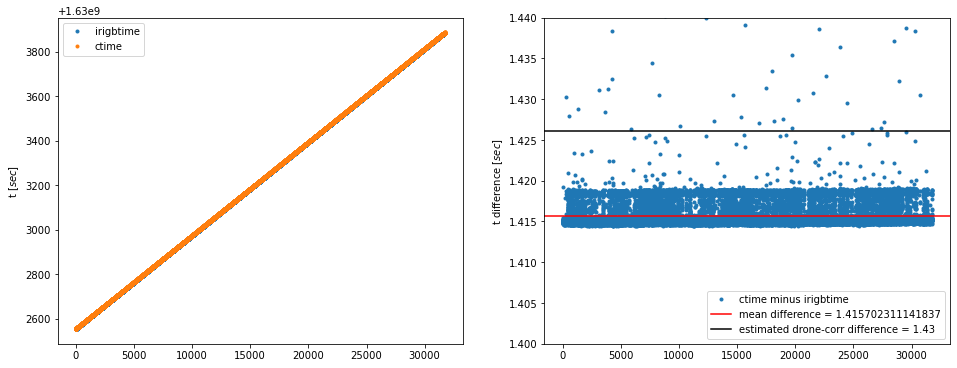

In [3]:
from matplotlib.colors import LogNorm
figure,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,7))
tstep=(concattest0825.t_arr_datetime[11]-concattest0825.t_arr_datetime[10]).total_seconds()
x=34
ax1.set_facecolor('k')
ax1.scatter(concattest0825.drone_xyz_LC_interp[x:,0],concattest0825.drone_xyz_LC_interp[x:,1],c=concattest0825.V_bgsub[:-x,900,0],norm=LogNorm())
ax2.set_facecolor('k')
ax2.scatter(concattest0825.drone_xyz_LC_interp[x:,0],concattest0825.drone_xyz_LC_interp[x:,1],c=concattest0825.V_bgsub[:-x,900,1],norm=LogNorm())
print('Applied offset is {} seconds'.format(tstep*x))

fullc=np.zeros((len(concattest0825.filenames),256))
fullirigb=np.zeros((len(concattest0825.filenames),256))

for i,fn in enumerate(concattest0825.filenames):
    fd=h5py.File(concattest0825.Data_Directory+fn,'r')
    fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
    fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    
fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
t_arr_irigb=np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)

fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
ax1.plot(fullirigb,'.',label='irigbtime')
ax1.plot(fullc,'.',label='ctime')
ax1.set_ylabel('t $[sec]$')
ax1.legend()

ax2.plot(fullc-fullirigb,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(fullc-fullirigb),c='r',label='mean difference = {}'.format(np.nanmean(fullc-fullirigb)))
ax2.set_ylabel('t difference $[sec]$')
ax2.axhline(tstep*x,c='k',label='estimated drone-corr difference = {:.2f}'.format(tstep*x))
ax2.set_ylim(1.4,1.44)
ax2.legend()

Timestamp interpolation succeeded
[1.63000266e+09 1.63000266e+09 1.63000266e+09 1.63000266e+09]
[1.63000266e+09 1.63000266e+09 1.63000266e+09 1.63000266e+09]
0.5106664412294668


<ipython-input-4-2ddac30fdc87>:9: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
<ipython-input-4-2ddac30fdc87>:10: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


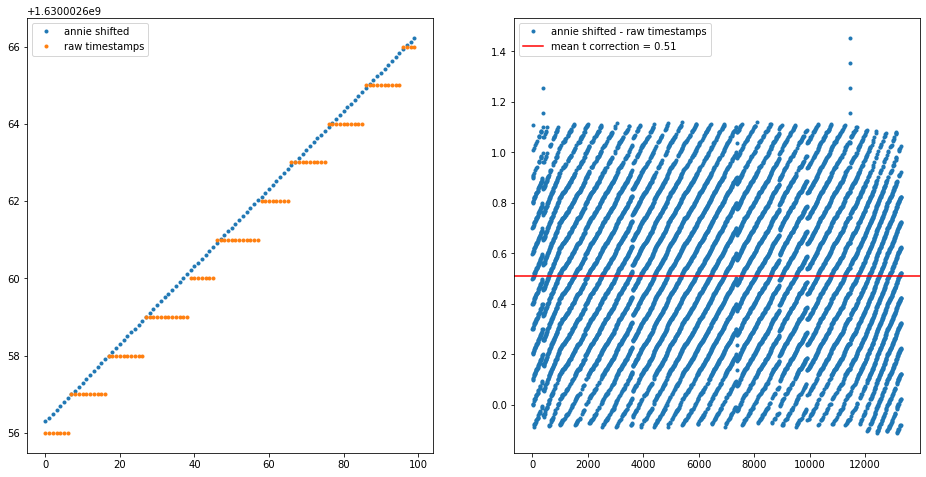

In [4]:
import pandas
dronefileraw=pandas.read_csv(concattest0825.Drone_Directory+concattest0825.FLYTAG,skiprows=np.arange(1,500).tolist(),low_memory=False)
rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')


figure3,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,8))
epoch=datetime.datetime.utcfromtimestamp(0)
rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])

print(rawdronetimef64[:4])
print(rawdronetimeoldf64[:4])
x=3852
ax1.plot(rawdronetimef64[:100],'.',label='annie shifted')
ax1.plot(rawdronetimeoldf64[:100],'.',label='raw timestamps')
ax1.legend()
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:250])
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:250])

ax2.plot(rawdronetimef64[:]-rawdronetimeoldf64[:],'.',label='annie shifted - raw timestamps')
meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
print(meantdiff)
ax2.axhline(meantdiff,c='r',label='mean t correction = {:.2f}'.format(meantdiff))
ax2.legend()

Initializing Correlator Class using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> Arrays initialized with shape (97, 256, 1024, 8)
Assigning array values by reading in data files:
 --> Loading File: 0096/0096Initializing drone data via datcon_csv routine: FLY534.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK data contains 12316/12316 non-nan values
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Maximum Pearson_R Correlations:
  --> t_indic

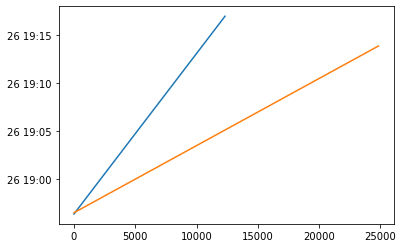

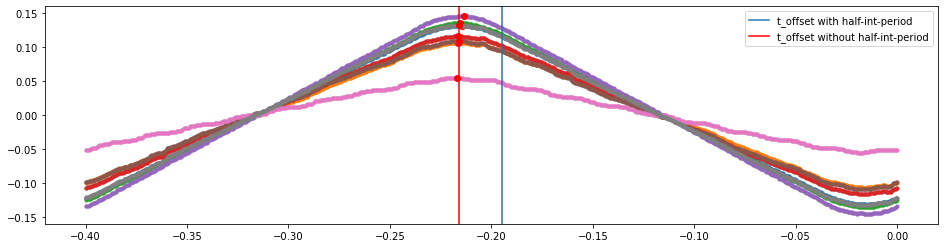

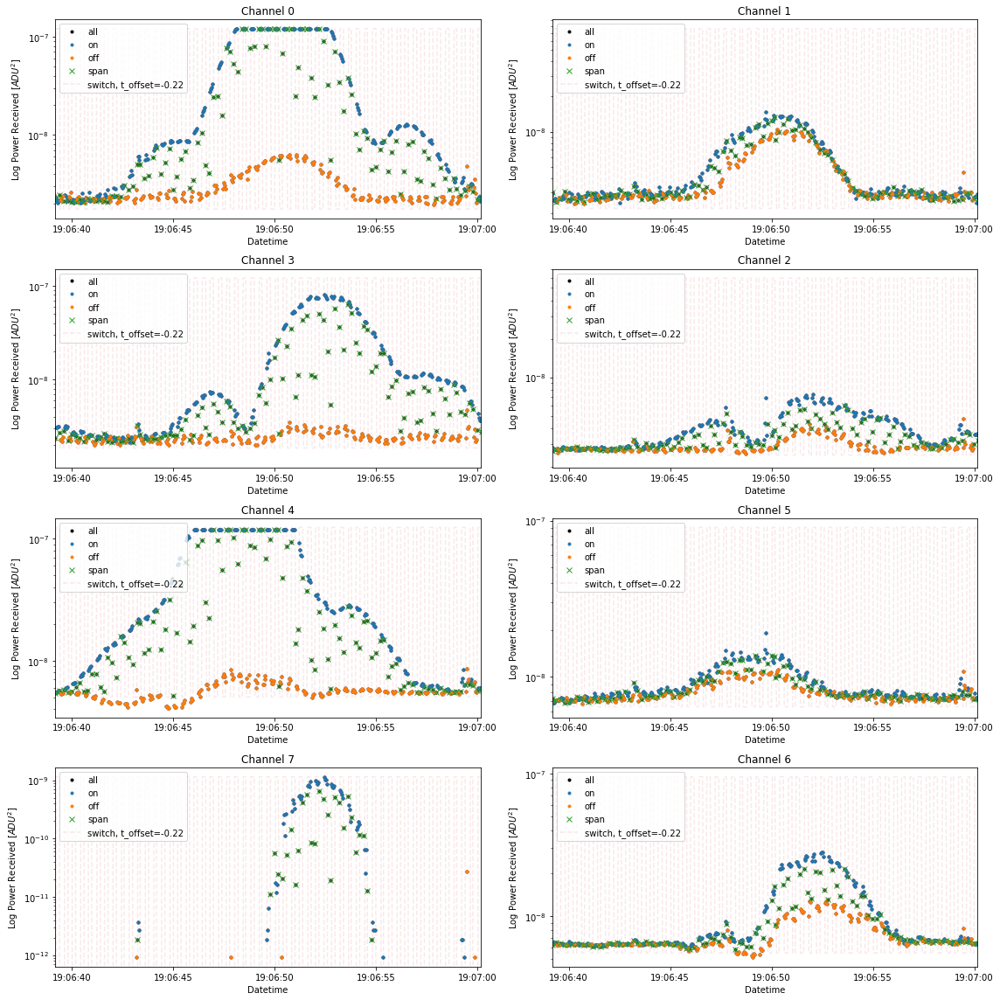

In [5]:
## 2) 0826 -- Flight from 20210826T185621: Comments only include "Large Grid 3"

## Read in the Corr_Data class:
datadir='/hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/'
gaindir='/hirax/GBO_Aug_2021/TONE_ACQ/digital_gains/20210826T185621Z_yale_drone_yale_digitalgain/'
corrtest0826=corr.Corr_Data(Data_Directory=datadir,Gain_Directory=gaindir,site_class=gbosite)

## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest0826=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY534.csv',site_class=gbosite)

## Since we know the data are from the same time we can combine them with the Concat_Class:
plot(dronetest0826.t_arr_datetime)
plot(corrtest0826.t_arr_datetime)
concattest0826=concat.CONCAT(CORRDATCLASS=corrtest0826,DRONEDATCLASS=dronetest0826)

## Use the Extract_Source_Pulses and Perform_Background_Subtraction functions:
concattest0826.Extract_Source_Pulses(Period=0.4e6,Dutycycle=0.2e6,t_bounds=[14500,15000])
concattest0826.Perform_Background_Subtraction()

Applied offset is 1.509984 seconds


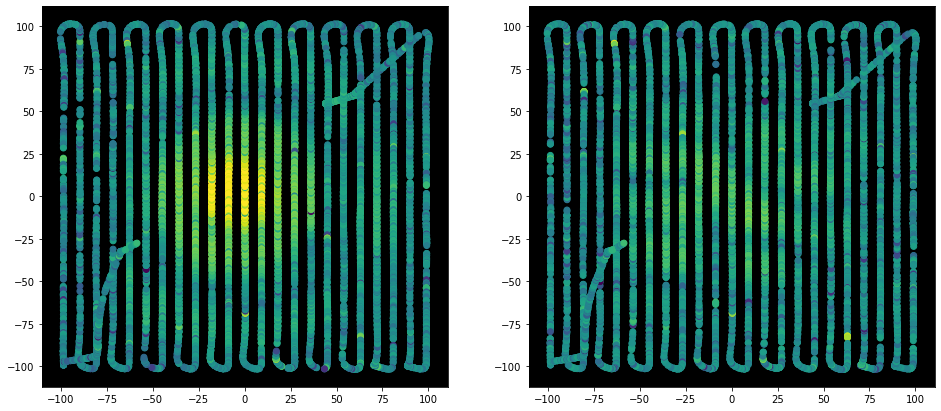

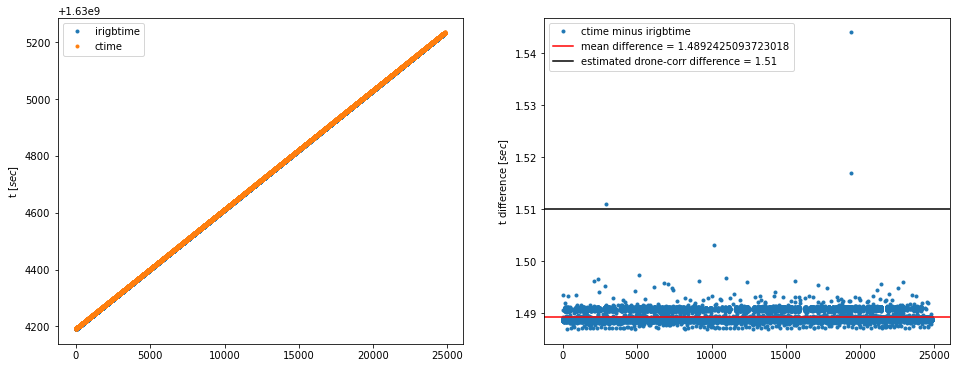

In [6]:
from matplotlib.colors import LogNorm
figure,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,7))
tstep=(concattest0826.t_arr_datetime[11]-concattest0826.t_arr_datetime[10]).total_seconds()
x=36
ax1.set_facecolor('k')
ax1.scatter(concattest0826.drone_xyz_LC_interp[x:,0],concattest0826.drone_xyz_LC_interp[x:,1],c=concattest0826.V_bgsub[:-x,900,0],norm=LogNorm())
ax2.set_facecolor('k')
ax2.scatter(concattest0826.drone_xyz_LC_interp[x:,0],concattest0826.drone_xyz_LC_interp[x:,1],c=concattest0826.V_bgsub[:-x,900,1],norm=LogNorm())
print('Applied offset is {} seconds'.format(tstep*x))

fullc=np.zeros((len(concattest0826.filenames),256))
fullirigb=np.zeros((len(concattest0826.filenames),256))

for i,fn in enumerate(concattest0826.filenames):
    fd=h5py.File(concattest0826.Data_Directory+fn,'r')
    fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
    fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    
fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
t_arr_irigb=np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)

fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
ax1.plot(fullirigb,'.',label='irigbtime')
ax1.plot(fullc,'.',label='ctime')
ax1.set_ylabel('t $[sec]$')
ax1.legend()

ax2.plot(fullc-fullirigb,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(fullc-fullirigb),c='r',label='mean difference = {}'.format(np.nanmean(fullc-fullirigb)))
ax2.axhline(tstep*x,c='k',label='estimated drone-corr difference = {:.2f}'.format(tstep*x))
ax2.set_ylabel('t difference $[sec]$')
ax2.legend()

Timestamp interpolation succeeded
[1.63000418e+09 1.63000418e+09 1.63000418e+09 1.63000418e+09]
[1.63000418e+09 1.63000418e+09 1.63000418e+09 1.63000418e+09]
0.5144543683579232


<ipython-input-7-ee5a7d2e762e>:8: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
<ipython-input-7-ee5a7d2e762e>:9: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


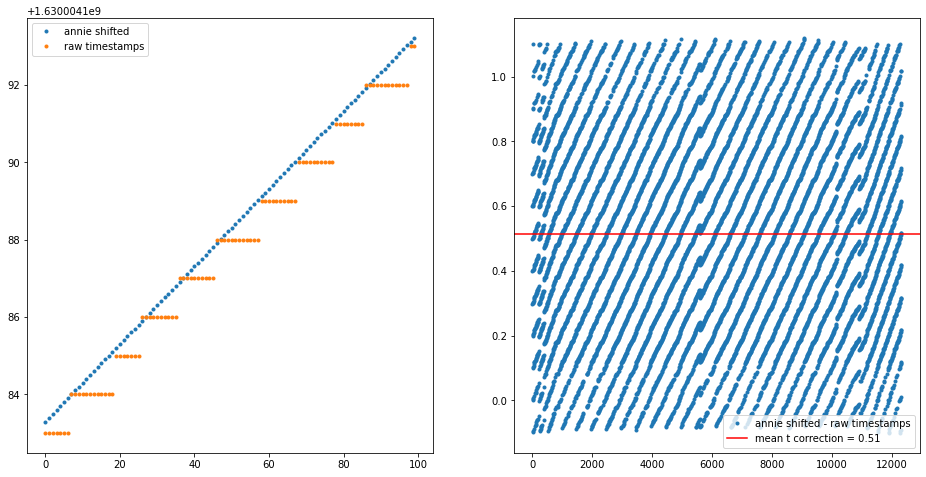

In [7]:
import pandas
dronefileraw=pandas.read_csv(concattest0826.Drone_Directory+concattest0826.FLYTAG,skiprows=np.arange(1,500).tolist(),low_memory=False)
rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')

figure3,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,8))
epoch=datetime.datetime.utcfromtimestamp(0)
rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])

print(rawdronetimef64[:4])
print(rawdronetimeoldf64[:4])
x=3852
ax1.plot(rawdronetimef64[:100],'.',label='annie shifted')
ax1.plot(rawdronetimeoldf64[:100],'.',label='raw timestamps')
ax1.legend()
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:250])
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:250])

ax2.plot(rawdronetimef64[:]-rawdronetimeoldf64[:],'.',label='annie shifted - raw timestamps')
meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
print(meantdiff)
ax2.axhline(meantdiff,c='r',label='mean t correction = {:.2f}'.format(meantdiff))
ax2.legend()

Initializing Correlator Class using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> Arrays initialized with shape (97, 256, 1024, 16)
Assigning array values by reading in data files:
 --> Loading File: 0096/0096Initializing drone data via datcon_csv routine: FLY613.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK data contains 0/15570 non-nan values
 ----> RTK Data not usable for this data file...
 --> Loading position data from GPS(0) instead:
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  

/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarnin

Maximum Pearson_R Correlations:
  --> t_indices = [ 95.  89.  89.  89.  nan  nan  99.  89.  89.  89. 112.  87.  89.  nan
 106.  91.]
  --> t_offsets = [-0.36196196 -0.36436436 -0.36436436 -0.36436436         nan         nan
 -0.36036036 -0.36436436 -0.36436436 -0.36436436 -0.35515516 -0.36516517
 -0.36436436         nan -0.35755756 -0.36356356]
Selecting global time offset:
  --> global_t_offset = -0.3433928444
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:186: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  tight_layout()


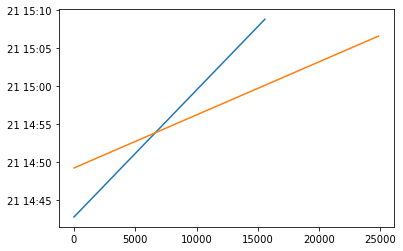

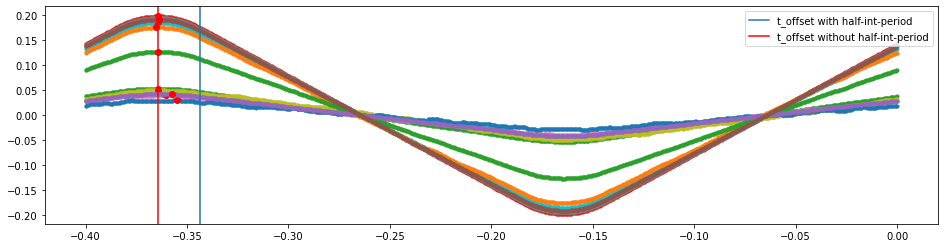

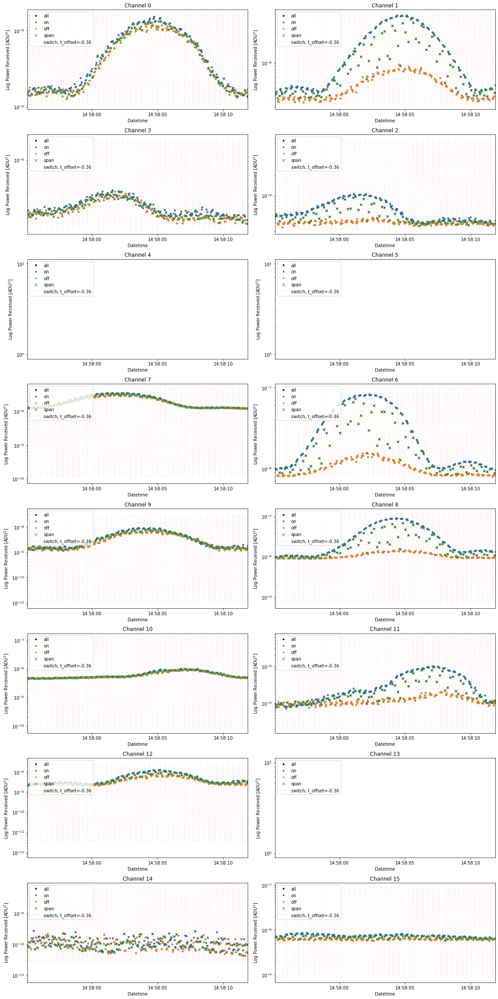

In [8]:
## 3) 1021 -- Flight from 20210826T185621: Comments only include "Large Grid 3"

## Read in the Corr_Data class:
datadir='/hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/'
gaindir='/hirax/GBO_Oct_2021/TONE_ACQ/digital_gains/20211021T144905Z_yale_drone_yale_digitalgain/'
corrtest1021=corr.Corr_Data(Data_Directory=datadir,Gain_Directory=gaindir,site_class=gbosite)

## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest1021=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY613.csv',site_class=gbosite)

## Since we know the data are from the same time we can combine them with the Concat_Class:
plot(dronetest1021.t_arr_datetime)
plot(corrtest1021.t_arr_datetime)
concattest1021=concat.CONCAT(CORRDATCLASS=corrtest1021,DRONEDATCLASS=dronetest1021)

## Use the Extract_Source_Pulses and Perform_Background_Subtraction functions:
concattest1021.Extract_Source_Pulses(Period=0.4e6,Dutycycle=0.2e6,t_bounds=[12400,12800])
concattest1021.Perform_Background_Subtraction()

Applied offset is 1.551928 seconds


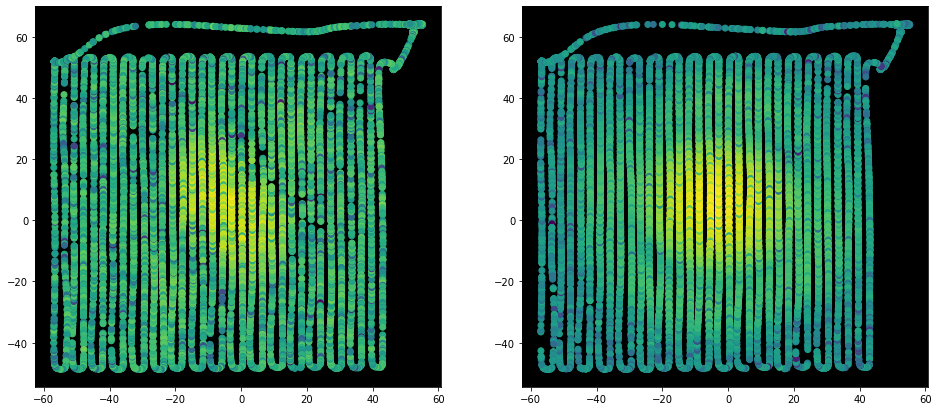

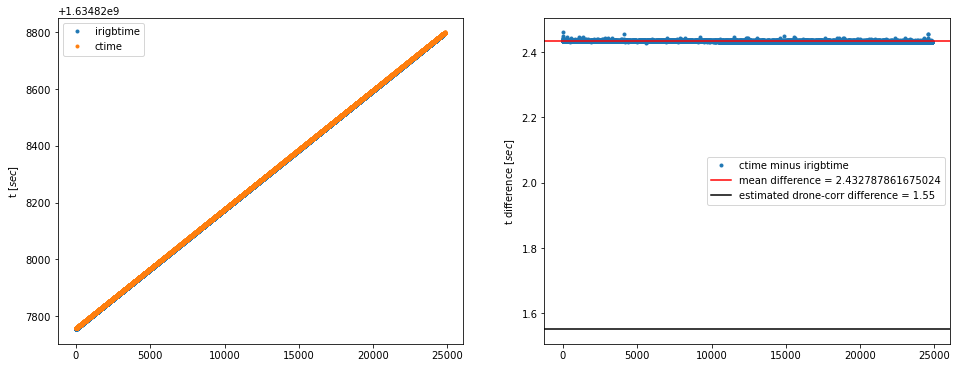

In [9]:
from matplotlib.colors import LogNorm
figure,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,7))
tstep=(concattest1021.t_arr_datetime[11]-concattest1021.t_arr_datetime[10]).total_seconds()
#x=58 # matches ctime-irigbtime value
x=37
ax1.set_facecolor('k')
ax1.scatter(concattest1021.drone_xyz_LC_interp[x:,0],concattest1021.drone_xyz_LC_interp[x:,1],c=concattest1021.V_bgsub[:-x,900,0],norm=LogNorm())
ax2.set_facecolor('k')
ax2.scatter(concattest1021.drone_xyz_LC_interp[x:,0],concattest1021.drone_xyz_LC_interp[x:,1],c=concattest1021.V_bgsub[:-x,900,1],norm=LogNorm())
print('Applied offset is {} seconds'.format(tstep*x))

fullc=np.zeros((len(concattest1021.filenames),256))
fullirigb=np.zeros((len(concattest1021.filenames),256))

for i,fn in enumerate(concattest1021.filenames):
    fd=h5py.File(concattest1021.Data_Directory+fn,'r')
    fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
    fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    
fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
t_arr_irigb=np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)

fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
ax1.plot(fullirigb,'.',label='irigbtime')
ax1.plot(fullc,'.',label='ctime')
ax1.set_ylabel('t $[sec]$')
ax1.legend()

ax2.plot(fullc-fullirigb,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(fullc-fullirigb),c='r',label='mean difference = {}'.format(np.nanmean(fullc-fullirigb)))
ax2.axhline(tstep*x,c='k',label='estimated drone-corr difference = {:.2f}'.format(tstep*x))
ax2.set_ylabel('t difference $[sec]$')
ax2.legend()

Timestamp interpolation succeeded
[1.63482737e+09 1.63482737e+09 1.63482737e+09 1.63482737e+09]
[1.63482737e+09 1.63482737e+09 1.63482737e+09 1.63482737e+09]
0.3219250495416963


<ipython-input-10-f400321cc05e>:8: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
<ipython-input-10-f400321cc05e>:9: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


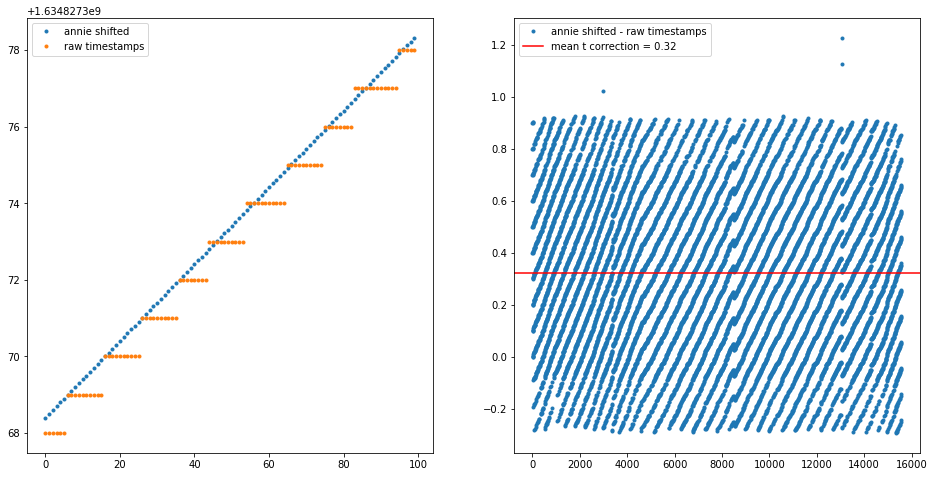

In [10]:
import pandas
dronefileraw=pandas.read_csv(concattest1021.Drone_Directory+concattest1021.FLYTAG,skiprows=np.arange(1,500).tolist(),low_memory=False)
rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')

figure3,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,8))
epoch=datetime.datetime.utcfromtimestamp(0)
rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])

print(rawdronetimef64[:4])
print(rawdronetimeoldf64[:4])
x=3852
ax1.plot(rawdronetimef64[:100],'.',label='annie shifted')
ax1.plot(rawdronetimeoldf64[:100],'.',label='raw timestamps')
ax1.legend()
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:250])
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:250])

ax2.plot(rawdronetimef64[:]-rawdronetimeoldf64[:],'.',label='annie shifted - raw timestamps')
meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
print(meantdiff)
ax2.axhline(meantdiff,c='r',label='mean t correction = {:.2f}'.format(meantdiff))
ax2.legend()

Initializing Correlator Class using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> Arrays initialized with shape (113, 256, 1024, 16)
Assigning array values by reading in data files:
 --> Loading File: 0112/0112Initializing drone data via datcon_csv routine: FLY649.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK Data not found for this data file...
 --> Loading position data from GPS(0) instead:
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26832 elements
  --> drone timestamp axis contains 11489 elements

/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]


Maximum Pearson_R Correlations:
  --> t_indices = [554. 551. 566. 566. 552. 565. 555. 554. 561. 560. 560. 561. 561.  nan
 572. 573.]
  --> t_offsets = [-0.17817818 -0.17937938 -0.17337337 -0.17337337 -0.17897898 -0.17377377
 -0.17777778 -0.17817818 -0.17537538 -0.17577578 -0.17577578 -0.17537538
 -0.17537538         nan -0.17097097 -0.17057057]
Selecting global time offset:
  --> global_t_offset = -0.1544038554
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:186: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  tight_layout()


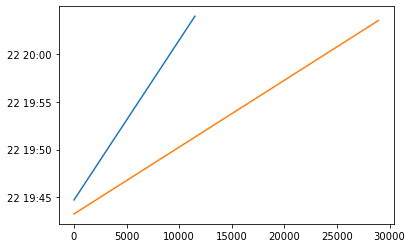

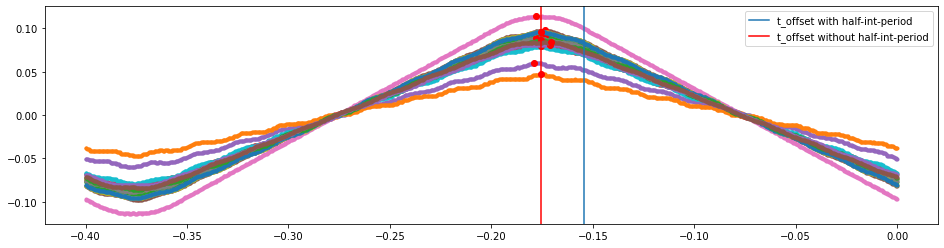

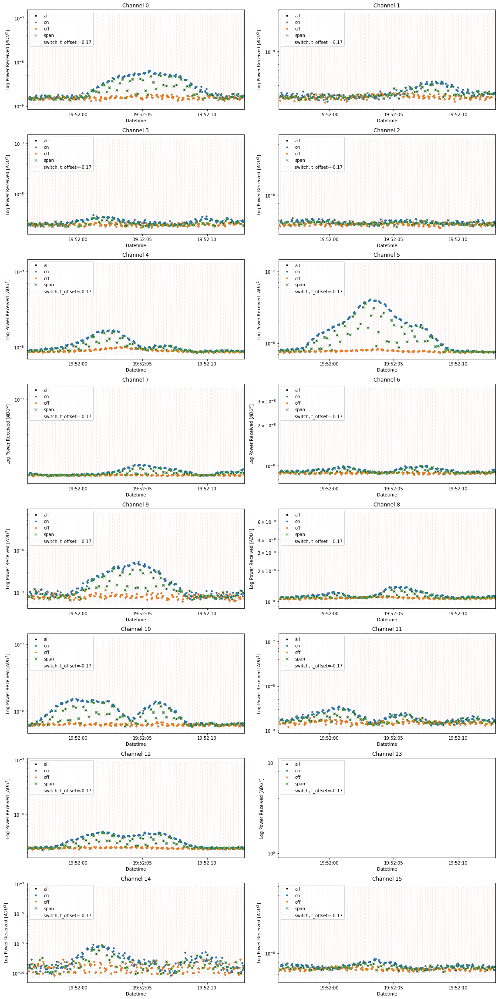

In [11]:
## Trying to examine time offsets from different flights to look for patterns/systematic issues:
## 4) 1022 -- Flight from 20211022T194308: Comments only include "Big Grid 4"

## Read in the Corr_Data class:
datadir='/hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/'
gaindir='/hirax/GBO_Oct_2021/TONE_ACQ/digital_gains/20211022T194308Z_yale_drone_yale_digitalgain/'
corrtest1022=corr.Corr_Data(Data_Directory=datadir,Gain_Directory=gaindir,site_class=gbosite)

## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest1022=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY649.csv',site_class=gbosite)

## Since we know the data are from the same time we can combine them with the Concat_Class:
plot(dronetest1022.t_arr_datetime)
plot(corrtest1022.t_arr_datetime)
concattest1022=concat.CONCAT(CORRDATCLASS=corrtest1022,DRONEDATCLASS=dronetest1022)

## Use the Extract_Source_Pulses and Perform_Background_Subtraction functions:
concattest1022.Extract_Source_Pulses(Period=0.4e6,Dutycycle=0.2e6,t_bounds=[12400,12800])
concattest1022.Perform_Background_Subtraction()

Applied offset is 3.77496 seconds


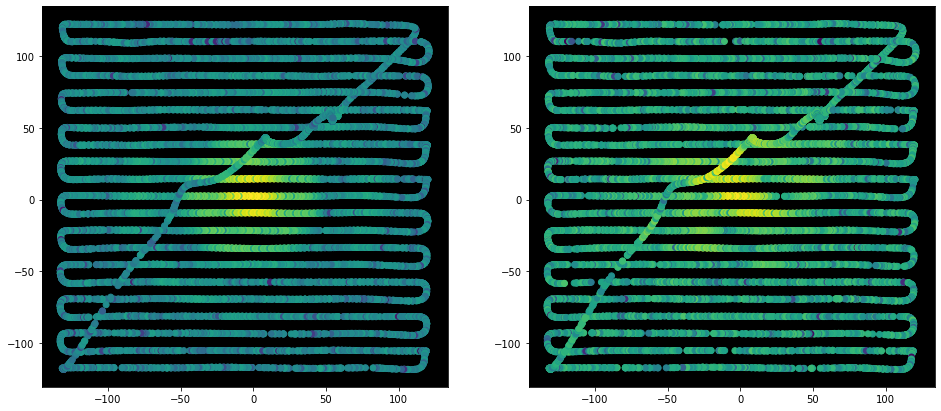

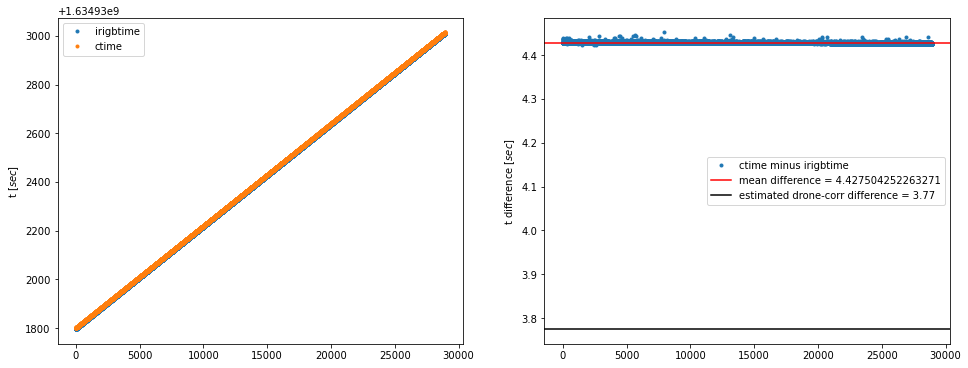

In [12]:
from matplotlib.colors import LogNorm
figure,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,7))
tstep=(concattest1022.t_arr_datetime[11]-concattest1022.t_arr_datetime[10]).total_seconds()
#x=106 #matches ctime-irigbtime value
x=90

ax1.set_facecolor('k')
ax1.scatter(concattest1022.drone_xyz_LC_interp[x:,0],concattest1022.drone_xyz_LC_interp[x:,1],c=concattest1022.V_bgsub[:-x,900,0],norm=LogNorm())
ax2.set_facecolor('k')
ax2.scatter(concattest1022.drone_xyz_LC_interp[x:,0],concattest1022.drone_xyz_LC_interp[x:,1],c=concattest1022.V_bgsub[:-x,900,1],norm=LogNorm())
print('Applied offset is {} seconds'.format(tstep*x))

fullc=np.zeros((len(concattest1022.filenames),256))
fullirigb=np.zeros((len(concattest1022.filenames),256))

for i,fn in enumerate(concattest1022.filenames):
    fd=h5py.File(concattest1022.Data_Directory+fn,'r')
    fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
    fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    
fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
t_arr_irigb=np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)

fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
ax1.plot(fullirigb,'.',label='irigbtime')
ax1.plot(fullc,'.',label='ctime')
ax1.set_ylabel('t $[sec]$')
ax1.legend()

ax2.plot(fullc-fullirigb,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(fullc-fullirigb),c='r',label='mean difference = {}'.format(np.nanmean(fullc-fullirigb)))
ax2.axhline(tstep*x,c='k',label='estimated drone-corr difference = {:.2f}'.format(tstep*x))
ax2.set_ylabel('t difference $[sec]$')
ax2.legend()

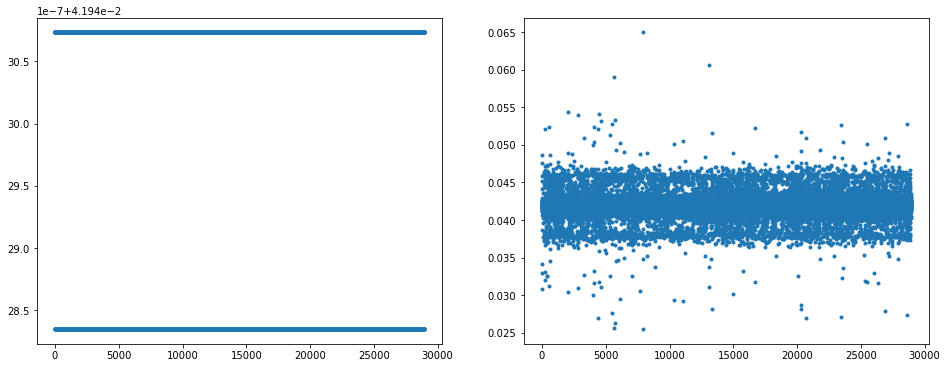

In [13]:
fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
ax1.plot(np.diff(fullirigb),'.',label='irigbtime')
ax2.plot(np.diff(fullc),'.',label='ctime')

Timestamp interpolation succeeded
[1.63493188e+09 1.63493188e+09 1.63493188e+09 1.63493188e+09]
[1.63493188e+09 1.63493188e+09 1.63493188e+09 1.63493188e+09]
0.37872860991764923


<ipython-input-14-eb7330b878fc>:9: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
<ipython-input-14-eb7330b878fc>:10: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


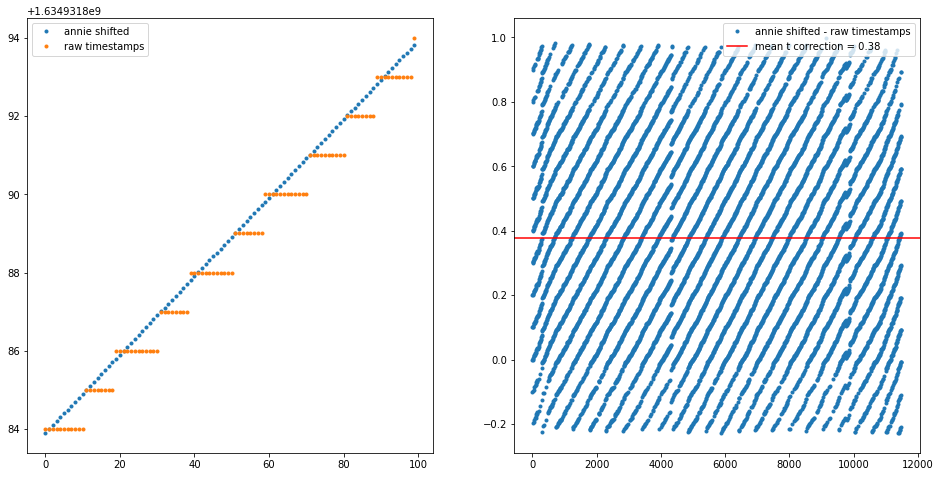

In [14]:
import pandas
dronefileraw=pandas.read_csv(concattest1022.Drone_Directory+concattest1022.FLYTAG,skiprows=np.arange(1,500).tolist(),low_memory=False)
rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')


figure3,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,8))
epoch=datetime.datetime.utcfromtimestamp(0)
rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])

print(rawdronetimef64[:4])
print(rawdronetimeoldf64[:4])
x=3852
ax1.plot(rawdronetimef64[:100],'.',label='annie shifted')
ax1.plot(rawdronetimeoldf64[:100],'.',label='raw timestamps')
ax1.legend()
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:250])
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:250])

ax2.plot(rawdronetimef64[:]-rawdronetimeoldf64[:],'.',label='annie shifted - raw timestamps')
meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
print(meantdiff)
ax2.axhline(meantdiff,c='r',label='mean t correction = {:.2f}'.format(meantdiff))
ax2.legend()

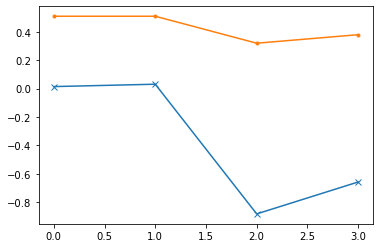

In [15]:
#print("File 0825 Offset is ~ {:.4f}s".format(2.43-1.55))
#print("File 0826 Offset is ~ {:.4f}s".format(2.43-1.55))
#print("File 1021 Offset is ~ {:.4f}s".format(2.43-1.55))
#print("File 1022 Offset is ~ {:.4f}s".format(4.42-3.77))


dtman=np.array([1.43,1.52,1.55,3.77])
dtcorr=np.array([1.4157,1.489,2.433,4.428])
dtdrone=np.array([0.51,0.51,0.32,0.38])

#1.43-1.4157, 0.51s
#1.52-1.489, 0.51s
#1.55-2.433, 0.32s
#3.77-4.428, 0.38s

plot(dtman-dtcorr,'x-')
#plot(dtcorr,'.-')
plot(dtdrone,'.-')

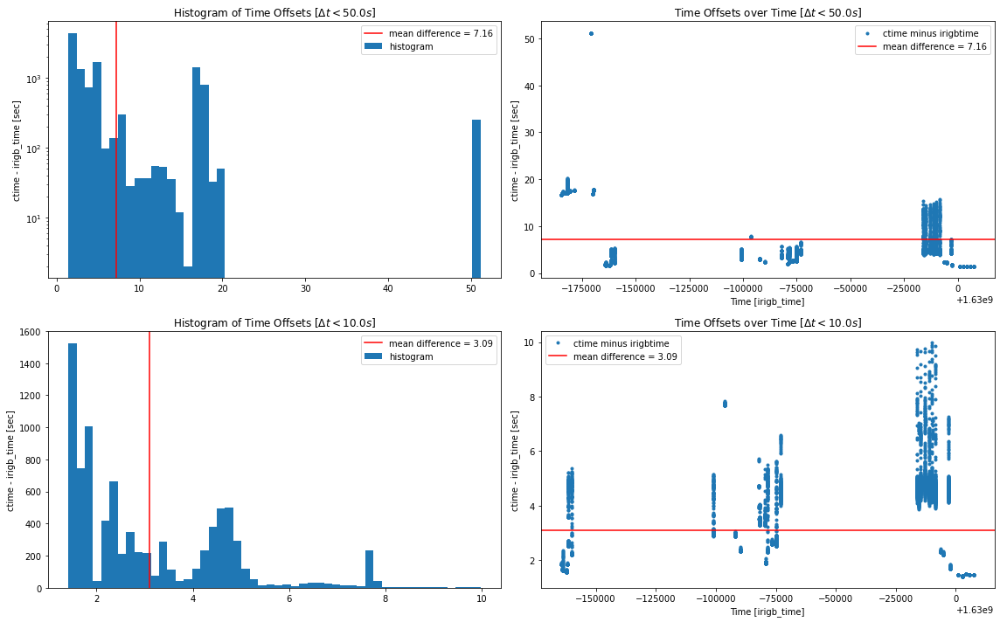

In [16]:
prefix08=concattest0825.Data_Directory.split('202108')[0]
dirlist08=np.sort(os.listdir(prefix08))
dirlist08=np.array([x for x in dirlist08 if '2021' in x])

fullc=np.zeros((len(dirlist08),256))
fullirigb=np.zeros((len(dirlist08),256))

for i,dirhome in enumerate(dirlist08):
    try:
        fd=h5py.File(prefix08+dirlist08[i]+'/corr/'+os.listdir(prefix08+dirlist08[i]+'/corr/')[0]+'/0005','r')
        fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
        fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    except FileNotFoundError:
        fullc[i]=np.NAN*np.zeros(256)
        fullirigb[i]=np.NAN*np.zeros(256)
    except ValueError:
        fullc[i]=np.NAN*np.zeros(256)
        fullirigb[i]=np.NAN*np.zeros(256)    
    except OSError:
        fullc[i]=np.NAN*np.zeros(256)
        fullirigb[i]=np.NAN*np.zeros(256)
    fd.close()

fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
deltcorr=fullc-fullirigb
deltcorr10=deltcorr[deltcorr<10.0]

fig,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,10))
ax1.hist(deltcorr,bins=50,label='histogram')
ax1.axvline(np.nanmean(deltcorr),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr)))
ax1.semilogy()
ax2.plot(fullc,deltcorr,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(deltcorr),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr)))
ax3.hist(deltcorr10,bins=50,label='histogram')
ax3.axvline(np.nanmean(deltcorr10),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr10)))
ax4.plot(fullc[deltcorr<10.0],deltcorr10,'.',label='ctime minus irigbtime')
ax4.axhline(np.nanmean(deltcorr10),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr10)))

TitleKeys=["[$\Delta t<50.0s$]","[$\Delta t<10.0s$]"]
for i,ax in enumerate([ax1,ax3]):
    ax.set_title("Histogram of Time Offsets {}".format(TitleKeys[i]))
    ax.set_ylabel("Occurences")
    ax.set_ylabel("ctime - irigb_time [sec]")
    ax.legend()
for i,ax in enumerate([ax2,ax4]):
    ax.set_title("Time Offsets over Time {}".format(TitleKeys[i]))
    ax.set_ylabel("ctime - irigb_time [sec]")
    ax.set_xlabel("Time [irigb_time]")
    ax.legend()
    
tight_layout()

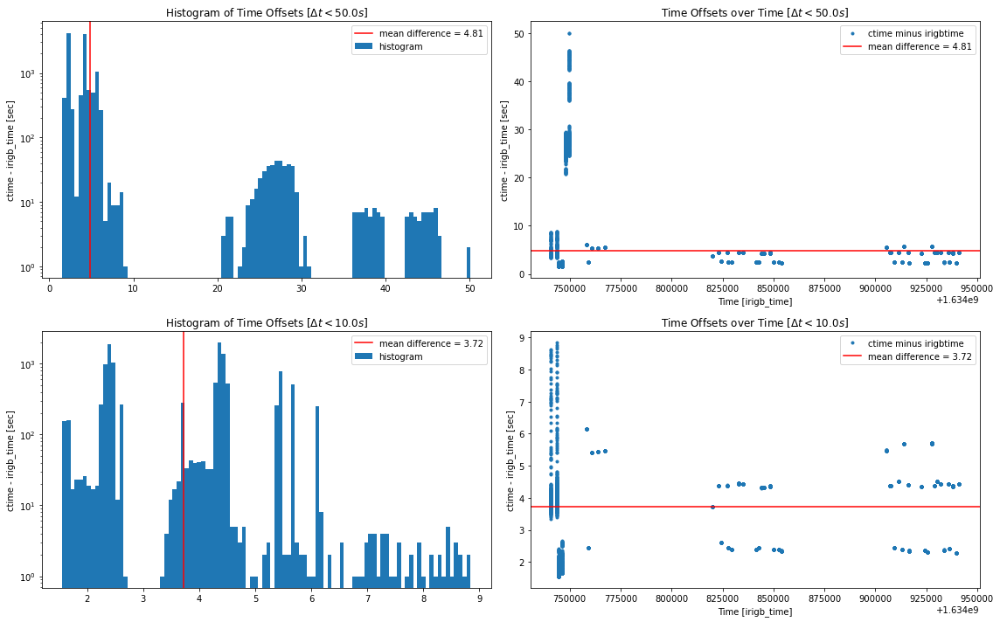

In [17]:
prefix10=concattest1021.Data_Directory.split('202110')[0]
dirlist10=np.sort(os.listdir(prefix10))
dirlist10=np.array([x for x in dirlist10 if '2021' in x])

fullc=np.zeros((len(dirlist10),256))
fullirigb=np.zeros((len(dirlist10),256))

for i,dirhome in enumerate(dirlist10):
    try:
        fd=h5py.File(prefix10+dirlist10[i]+'/corr/'+os.listdir(prefix10+dirlist10[i]+'/corr/')[0]+'/0005','r')
        fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
        fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    except FileNotFoundError:
        fullc[i]=np.NAN*np.zeros(256)
        fullirigb[i]=np.NAN*np.zeros(256)
    except ValueError:
        fullc[i]=np.NAN*np.zeros(256)
        fullirigb[i]=np.NAN*np.zeros(256)    
    except OSError:
        fullc[i]=np.NAN*np.zeros(256)
        fullirigb[i]=np.NAN*np.zeros(256)
    fd.close()

fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
deltcorr=fullc-fullirigb
deltcorr10=deltcorr[deltcorr<10.0]

fig,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,10))
ax1.hist(deltcorr,bins=100,label='histogram')
ax1.axvline(np.nanmean(deltcorr),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr)))
ax1.semilogy()
ax2.plot(fullc,deltcorr,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(deltcorr),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr)))
ax3.hist(deltcorr10,bins=100,label='histogram')
ax3.axvline(np.nanmean(deltcorr10),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr10)))
ax3.semilogy()
ax4.plot(fullc[deltcorr<10.0],deltcorr10,'.',label='ctime minus irigbtime')
ax4.axhline(np.nanmean(deltcorr10),c='r',label='mean difference = {:.2f}'.format(np.nanmean(deltcorr10)))

TitleKeys=["[$\Delta t<50.0s$]","[$\Delta t<10.0s$]"]
for i,ax in enumerate([ax1,ax3]):
    ax.set_title("Histogram of Time Offsets {}".format(TitleKeys[i]))
    ax.set_ylabel("Occurences")
    ax.set_ylabel("ctime - irigb_time [sec]")
    ax.legend()
for i,ax in enumerate([ax2,ax4]):
    ax.set_title("Time Offsets over Time {}".format(TitleKeys[i]))
    ax.set_ylabel("ctime - irigb_time [sec]")
    ax.set_xlabel("Time [irigb_time]")
    ax.legend()
    
tight_layout()

In [19]:
## Let's calculate the mean time difference for ALL drone files...
#stop
meantdiffarr=np.zeros(len(np.sort(os.listdir(concattest0825.Drone_Directory))))
for i,fn in enumerate(np.sort(os.listdir(concattest0825.Drone_Directory))):
    try:
        dronefileraw=pandas.read_csv(concattest0825.Drone_Directory+fn,skiprows=np.arange(1,500).tolist(),low_memory=False)
        rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
        rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')
        epoch=datetime.datetime.utcfromtimestamp(0)
        rawdronetimef64=np.array([z.timestamp() for z in rawdronetime])
        rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
        meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
        #print(i,fn,meantdiff)
        meantdiffarr[i]=meantdiff
    except IndexError:
        meantdiffarr[i]=np.nan
    except KeyError:
        meantdiffarr[i]=np.nan


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s e

Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s e

Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s e

Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
/home/tyndall/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/tyndall/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Detected >1s error, retrying
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])
<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded
Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s error, retrying
Detected >1s e

<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


Timestamp interpolation succeeded


<ipython-input-19-0fb639eef1c0>:11: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


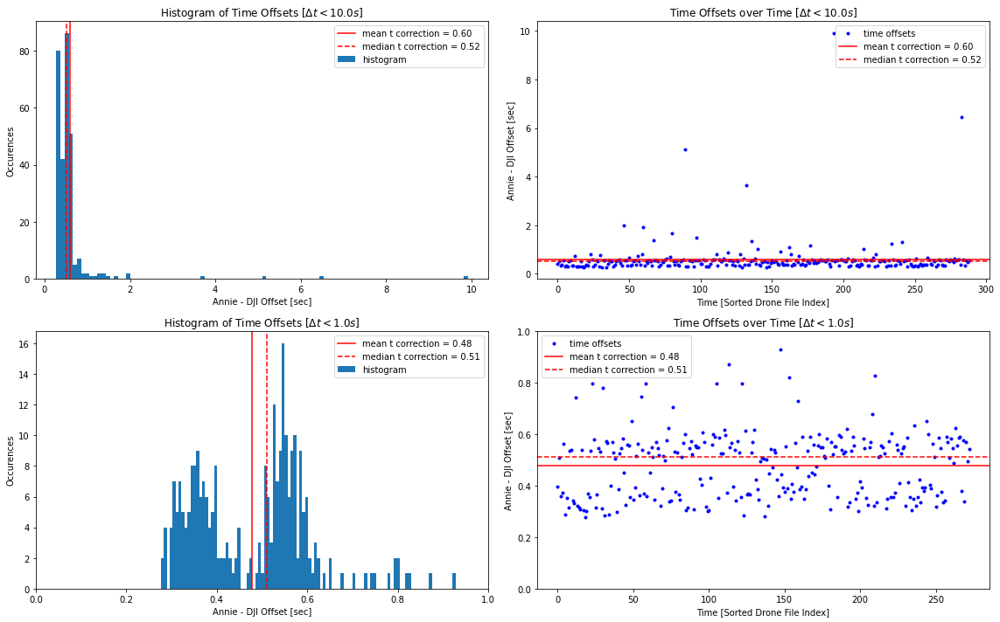

In [20]:
figure3,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,10))
ax1.hist(meantdiffarr[meantdiffarr<10.0],bins=100,label='histogram')
ax2.plot(meantdiffarr[meantdiffarr<10.0],'b.',label='time offsets')
ax3.hist(meantdiffarr[meantdiffarr<1.0],bins=100,label='histogram')
ax4.plot(meantdiffarr[meantdiffarr<1.0],'b.',label='time offsets')

medtd10=np.nanmedian(meantdiffarr[meantdiffarr<10.0])
medtd1=np.nanmedian(meantdiffarr[meantdiffarr<1.0])
meantd10=np.nanmean(meantdiffarr[meantdiffarr<10.0])
meantd1=np.nanmean(meantdiffarr[meantdiffarr<1.0])

TitleKeys=["[$\Delta t<10.0s$]","[$\Delta t<1.0s$]"]
meantds=[meantd10,meantd1]
medtds=[medtd10,medtd1]

for i,ax in enumerate([ax1,ax3]):
    ax.axvline(meantds[i],c='r',label='mean t correction = {:.2f}'.format(meantds[i]))
    ax.axvline(medtds[i],c='r',linestyle='--',label='median t correction = {:.2f}'.format(medtds[i]))
    ax.set_title("Histogram of Time Offsets {}".format(TitleKeys[i]))
    ax.set_ylabel("Occurences")
    ax.set_xlabel("Annie - DJI Offset [sec]")
    ax.legend()
for i,ax in enumerate([ax2,ax4]):
    ax.axhline(meantds[i],c='r',label='mean t correction = {:.2f}'.format(meantds[i]))
    ax.axhline(medtds[i],c='r',linestyle='--',label='median t correction = {:.2f}'.format(medtds[i]))
    ax.set_title("Time Offsets over Time {}".format(TitleKeys[i]))
    ax.set_ylabel("Annie - DJI Offset [sec]")
    ax.set_xlabel("Time [Sorted Drone File Index]")
    ax.legend()
    
ax3.set_xlim(0,1)
ax4.set_ylim(0,1)
tight_layout()

Timestamp interpolation succeeded
[1.63000266e+09 1.63000266e+09 1.63000266e+09 1.63000266e+09]
[1.63000266e+09 1.63000266e+09 1.63000266e+09 1.63000266e+09]
0.5106664412294668


<ipython-input-21-182ab634d80a>:9: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
<ipython-input-21-182ab634d80a>:10: DeprecationWarning: parsing timezone aware datetimes is deprecated; this will raise an error in the future
  rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])


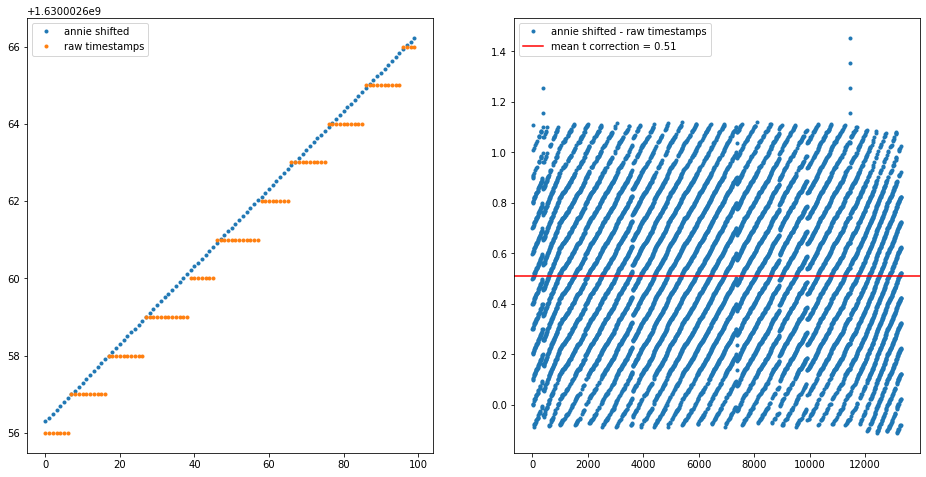

In [21]:
## Let's calculate the mean time difference for ALL drone files...
dronefileraw=pandas.read_csv(concattest0825.Drone_Directory+concattest0825.FLYTAG,skiprows=np.arange(1,500).tolist(),low_memory=False)
rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')


figure3,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,8))
epoch=datetime.datetime.utcfromtimestamp(0)
rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])

print(rawdronetimef64[:4])
print(rawdronetimeoldf64[:4])
x=3852
ax1.plot(rawdronetimef64[:100],'.',label='annie shifted')
ax1.plot(rawdronetimeoldf64[:100],'.',label='raw timestamps')
ax1.legend()
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:250])
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:250])

ax2.plot(rawdronetimef64[:]-rawdronetimeoldf64[:],'.',label='annie shifted - raw timestamps')
meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
print(meantdiff)
ax2.axhline(meantdiff,c='r',label='mean t correction = {:.2f}'.format(meantdiff))
ax2.legend()

Applied offset is 3.691072 seconds


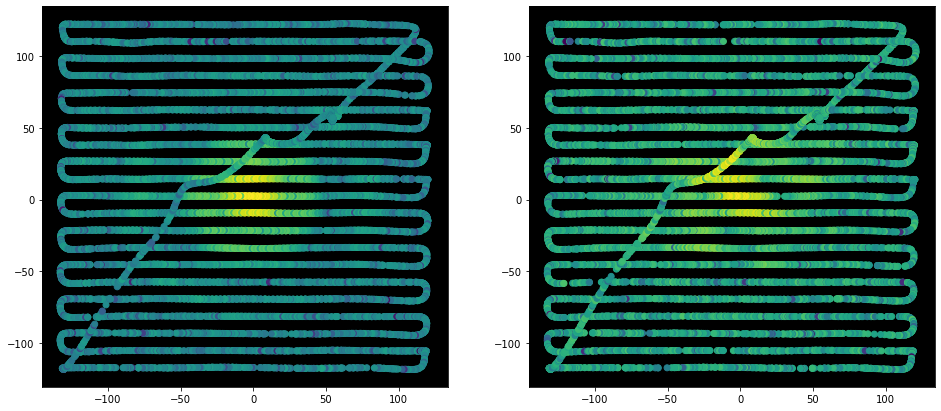

In [22]:
from matplotlib.colors import LogNorm
figure,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,7))
x=88
for i,ax in enumerate([ax1,ax2]):
    ax.set_facecolor('k')
    ax.scatter(concattest1022.drone_xyz_LC_interp[x:,0],concattest1022.drone_xyz_LC_interp[x:,1],c=concattest1022.V_bgsub[:-x,900,i],norm=LogNorm())
print('Applied offset is {} seconds'.format(tstep*x))

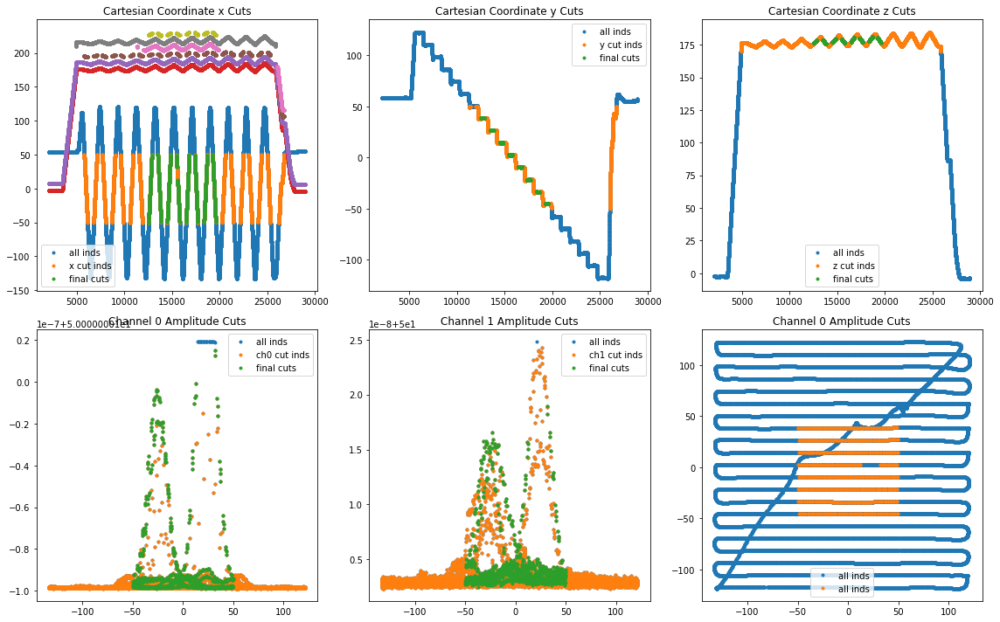

In [23]:
acut0=concattest1022.t_index[concattest1022.V[:,900,0]<0.98*(np.nanmax(concattest1022.V[:,900,0]))]
acut1=concattest1022.t_index[concattest1022.V[:,900,1]<0.98*(np.nanmax(concattest1022.V[:,900,1]))]
acut=np.intersect1d(acut0,acut1)
xcut=concattest1022.t_index[np.abs(concattest1022.drone_xyz_LC_interp[:,0])<50.0]
ycut=concattest1022.t_index[np.abs(concattest1022.drone_xyz_LC_interp[:,1])<50.0]
zcut=concattest1022.t_index[np.abs(concattest1022.drone_xyz_LC_interp[:,2])>170.0]
tcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(xcut,ycut),zcut),acut),concattest1022.inds_on)

xyzcut=[xcut,ycut,zcut]
xyzstrings=['x','y','z']
acuts=[acut0,acut1]
acutstrings=['ch0','ch1']

figure,[[ax1,ax2,ax3],[ax4,ax5,ax6]]=subplots(nrows=2,ncols=3,figsize=(16,10))
    

for i,ax in enumerate([ax1,ax2,ax3]):
    ax.set_title('Cartesian Coordinate {} Cuts'.format(xyzstrings[i]))  
    ax.plot(concattest1022.t_index[:],concattest1022.drone_xyz_LC_interp[:,i]+0,'.',label='all inds')                             
    ax.plot(concattest1022.t_index[xyzcut[i]],concattest1022.drone_xyz_LC_interp[xyzcut[i],i]+0,'.',label='{} cut inds'.format(xyzstrings[i]))                             
    ax.plot(concattest1022.t_index[tcut],concattest1022.drone_xyz_LC_interp[tcut,i]+0,'.',label='final cuts')                             
    ax.legend()
    
for i,ax in enumerate([ax4,ax5]):
    ax.set_title('Channel {} Amplitude Cuts'.format(i))  
    ax.plot(concattest1022.drone_xyz_LC_interp[:,0],concattest1022.V[:,900,i]+50,'.',label='all inds') 
    ax.plot(concattest1022.drone_xyz_LC_interp[acuts[i],0],concattest1022.V[acuts[i],900,i]+50,'.',label='{} cut inds'.format(acutstrings[i]))  
    ax.plot(concattest1022.drone_xyz_LC_interp[tcut,0],concattest1022.V[tcut,900,i]+50,'.',label='final cuts')  
    ax.legend()
    
for i,ax in enumerate([ax6]):
    ax.set_title('Channel {} Amplitude Cuts'.format(i))  
    ax.plot(concattest1022.drone_xyz_LC_interp[:,0],concattest1022.drone_xyz_LC_interp[:,1],'.',label='all inds') 
    ax.plot(concattest1022.drone_xyz_LC_interp[tcut,0],concattest1022.drone_xyz_LC_interp[tcut,1],'.',label='all inds') 
    #ax.plot(concattest1022.drone_xyz_LC_interp[acuts[i],0],concattest1022.V[acuts[i],900,i]+50,'.',label='{} cut inds'.format(acutstrings[i]))  
    #ax.plot(concattest1022.drone_xyz_LC_interp[tcut,0],concattest1022.V[tcut,900,i]+50,'.',label='final cuts')  
    ax.legend()
    
tight_layout()

ax1.plot(concattest1022.t_index[:],concattest1022.drone_xyz_LC_interp[:,2]+0,'.')                             
ax1.plot(concattest1022.t_index[acut],concattest1022.drone_xyz_LC_interp[acut,2]+10,'.')                             
ax1.plot(concattest1022.t_index[xcut],concattest1022.drone_xyz_LC_interp[xcut,2]+20,'.')
ax1.plot(concattest1022.t_index[ycut],concattest1022.drone_xyz_LC_interp[ycut,2]+30,'.')
ax1.plot(concattest1022.t_index[zcut],concattest1022.drone_xyz_LC_interp[zcut,2]+40,'.')
ax1.plot(concattest1022.t_index[tcut],concattest1022.drone_xyz_LC_interp[tcut,2]+50,'.')

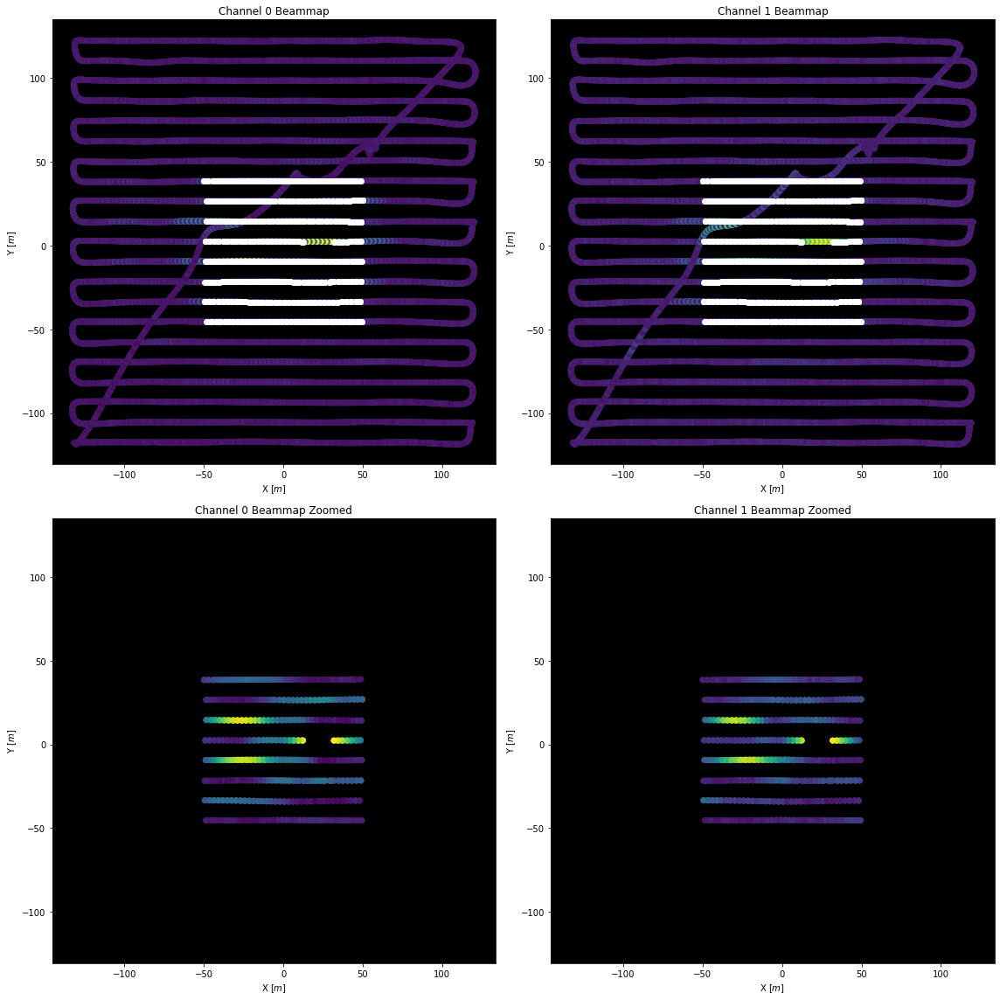

In [24]:
figure,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,16))
for i,ax in enumerate([ax1,ax2]):
    ax.set_title('Channel {} Beammap'.format(i))
    ax.set_facecolor('k')
    ax.scatter(concattest1022.drone_xyz_LC_interp[:,0],concattest1022.drone_xyz_LC_interp[:,1],c=concattest1022.V[:,900,i],norm=LogNorm())
    ax.plot(concattest1022.drone_xyz_LC_interp[tcut,0],concattest1022.drone_xyz_LC_interp[tcut,1],'wo') 
for i,ax in enumerate([ax3,ax4]):
    ax.set_title('Channel {} Beammap Zoomed'.format(i))
    ax.set_facecolor('k')
    excludedinds=list(set(concattest1022.t_index)-set(tcut))
    ax.plot(concattest1022.drone_xyz_LC_interp[excludedinds,0],concattest1022.drone_xyz_LC_interp[excludedinds,1],'.',markersize=0) 
    ax.scatter(concattest1022.drone_xyz_LC_interp[tcut,0],concattest1022.drone_xyz_LC_interp[tcut,1],c=concattest1022.V[tcut,900,i],norm=LogNorm())
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_xlabel('X $[m]$')
    ax.set_ylabel('Y $[m]$')
tight_layout()


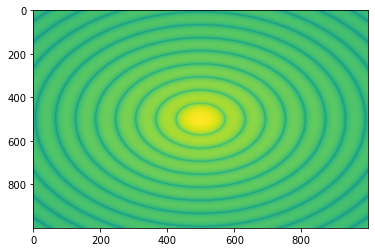

In [25]:
## Define fitting functions:
from scipy.optimize import least_squares

from astropy.modeling.models import AiryDisk2D

AD=AiryDisk2D(1,5,5,radius=1)
x=np.linspace(-60,60,1000)
y=np.linspace(-60,60,1000)
dat=np.zeros((len(x),len(y)))
for i,val in enumerate(x):
    dat[i]=AD.evaluate(val,y,10,0,0,radius=8.75)
    
imshow(dat,aspect="auto",norm=LogNorm())

def Airy_2d_LC_opt(P,x,y,V):
    amp,x0,y0,rad,c=P
    return AD.evaluate(x,y,amp,x0,y0,rad)+c-V

def Airy_2d_LC_func(P,x,y):
    amp,x0,y0,rad,c=P
    return AD.evaluate(x,y,amp,x0,y0,rad)+c

def Gauss_2d_LC_opt(P,x,y,V):
    amp,x0,xsig,y0,ysig,c=P
    return amp*np.exp(-0.5*((((x-x0)/xsig)**2.0)+(((y-y0)/ysig)**2.0)))+c-V

def Gauss_2d_LC_func(P,x,y):
    amp,x0,xsig,y0,ysig,c=P
    return amp*np.exp(-0.5*((((x-x0)/xsig)**2.0)+(((y-y0)/ysig)**2.0)))+c

In [26]:
from scipy.stats import pearsonr
pearsonr([0,1,2,3],[0,1,0,1])[0]

0.447213595499958

In [27]:
## Implement best-fit gauss-2d method for finding the best-fit time offset:
t_offset_range_coarse=np.arange(-7.5,7.5,0.2)

## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest1022=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY649.csv',site_class=gbosite)

## restrict channels and frequencies to fit:
chans=np.arange(0,2)
freqs=np.arange(0,1024,100)

## Define output products from fits:
AFit_f_params=np.zeros((len(t_offset_range_coarse),len(chans),len(freqs),5))
GFit_f_params=np.zeros((len(t_offset_range_coarse),len(chans),len(freqs),6))
PRarr=np.zeros((len(t_offset_range_coarse),len(chans),len(freqs)))

for i,ttry in enumerate(t_offset_range_coarse):
    origtaxis=dronetest1022.t_arr_datetime[:]
    tempdronetest=dronetest1022
    tempdronetest.t_arr_datetime=dronetest1022.t_arr_datetime+datetime.timedelta(seconds=ttry)
    tempconcat=concat.CONCAT(CORRDATCLASS=corrtest1022,DRONEDATCLASS=tempdronetest)
    dronetest1022.t_arr_datetime=origtaxis
    for j,chan in enumerate(chans):
        for k,find in enumerate(freqs):
            try:
                ## define timecuts for amplitude:
                tacut0=tempconcat.t_index[tempconcat.V[:,find,0]<0.98*(np.nanmax(tempconcat.V[:,find,0]))]
                tacut1=tempconcat.t_index[tempconcat.V[:,find,1]<0.98*(np.nanmax(tempconcat.V[:,find,1]))]
                tacut=np.intersect1d(tacut0,tacut1)
                ## define timecuts for cartesian coordinates:
                txcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,0])<50.0]
                tycut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,1])<50.0]
                tzcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,2])>170.0]
                ttcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut),concattest1022.inds_on)
                ## data points for fit:
                mbx=tempconcat.drone_xyz_LC_interp[ttcut,0]
                mby=tempconcat.drone_xyz_LC_interp[ttcut,1]
                mbz=tempconcat.drone_xyz_LC_interp[ttcut,2]
                mbV=tempconcat.V[ttcut,find,j]
                mb_input_data=np.array([mbx,mby,mbV])
                ## shared params:
                amp0=np.nanmax(mbV)
                bg0=np.nanmin(mbV)
                x00=tempconcat.dish_coords[int(j/2),0]
                y00=tempconcat.dish_coords[int(j/2),1]
                ## airy params:
                rad0=25.0
                ## 2dgauss params:
                xsig0=6.0
                ysig0=6.0
                ## initial guess and bounds:
                pA=np.array([amp0,x00,y00,rad0,bg0])
                #BA=(np.array([0.0,-50.0,-50.0,0.0]),np.array([1e-6,50,50,50]))
                pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
                #BG=(np.array([0.0,-30.0,0.0,-30.0,0.0]),np.array([1e-6,30,50,30,50]))
                ## run the fits:
                #AFit_f_params[i,j,k,:]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
                GFit_f_params[i,j,k,:]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
                PRarr[i,j,k]=pearsonr(mbV,Gauss_2d_LC_func(GFit_f_params[i,j,k,:],mbx,mby))[0]
            except ValueError:
                AFit_f_params[i,j,k,:]=np.NAN*np.zeros(5)
                GFit_f_params[i,j,k,:]=np.NAN*np.zeros(6)
                PRarr[i,j,k]=np.NAN

Initializing drone data via datcon_csv routine: FLY649.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK Data not found for this data file...
 --> Loading position data from GPS(0) instead:
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27011 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27006 elements
 

/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26992 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26987 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26982 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26863 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26858 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26853 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26734 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26729 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26725 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3943: PearsonRNearConstantInputWarning: An input array is nearly constant; the computed correlation coefficent may be inaccurate.
  warnings.warn(PearsonRNearConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26691 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26686 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26682 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

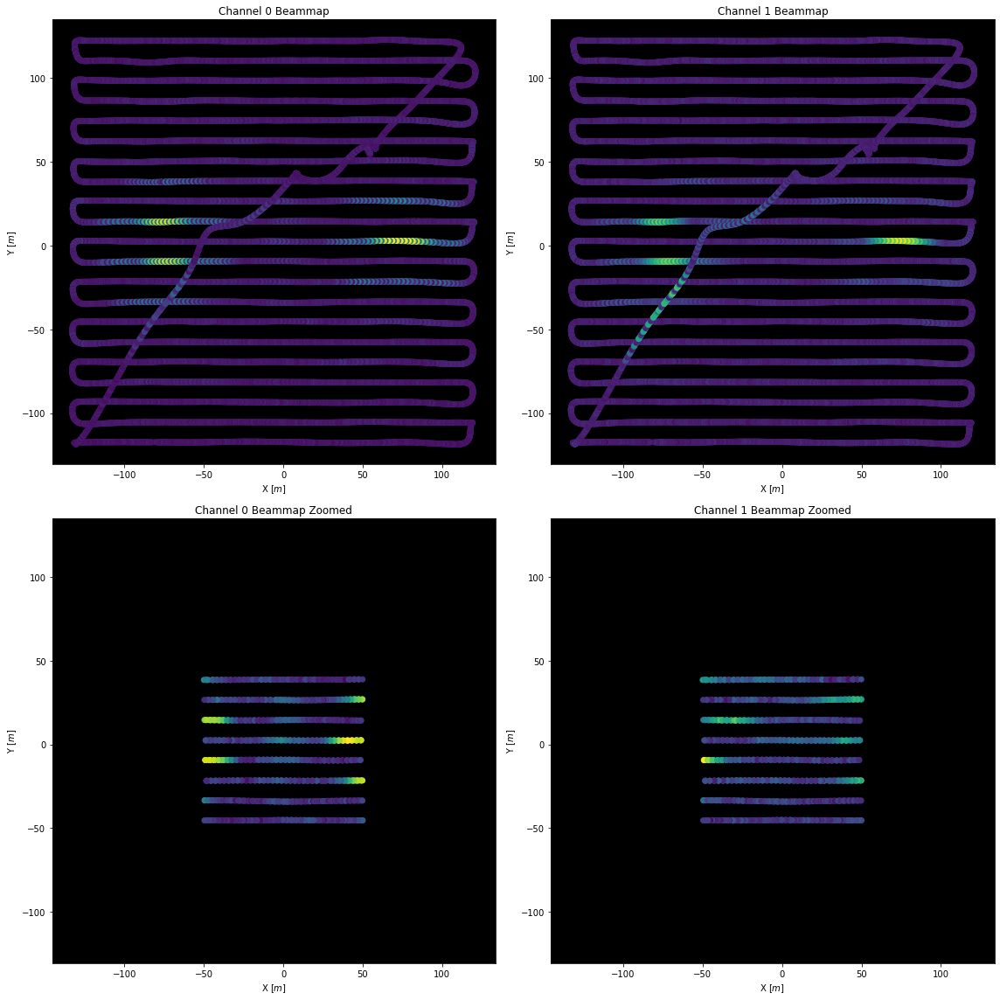

In [28]:
figure,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,16))
for i,ax in enumerate([ax1,ax2]):
    ax.set_title('Channel {} Beammap'.format(i))
    ax.set_facecolor('k')
    ax.scatter(tempconcat.drone_xyz_LC_interp[:,0],tempconcat.drone_xyz_LC_interp[:,1],c=tempconcat.V[:,900,i],norm=LogNorm())
    #ax.plot(tempconcat.drone_xyz_LC_interp[ttcut,0],tempconcat.drone_xyz_LC_interp[ttcut,1],'wo') 
for i,ax in enumerate([ax3,ax4]):
    ax.set_title('Channel {} Beammap Zoomed'.format(i))
    ax.set_facecolor('k')
    excludedinds=list(set(tempconcat.t_index)-set(tcut))
    ax.plot(tempconcat.drone_xyz_LC_interp[excludedinds,0],tempconcat.drone_xyz_LC_interp[excludedinds,1],'.',markersize=0) 
    ax.scatter(tempconcat.drone_xyz_LC_interp[ttcut,0],tempconcat.drone_xyz_LC_interp[ttcut,1],c=tempconcat.V[ttcut,900,i],norm=LogNorm())
for i,ax in enumerate([ax1,ax2,ax3,ax4]):
    ax.set_xlabel('X $[m]$')
    ax.set_ylabel('Y $[m]$')
tight_layout()


<ipython-input-29-91c6ff47693b>:11: RuntimeWarning: All-NaN slice encountered
  PRmax[i,j]=np.where(PRarr[:,i,j]==np.nanmax(PRarr[:,i,j]))[0][0]


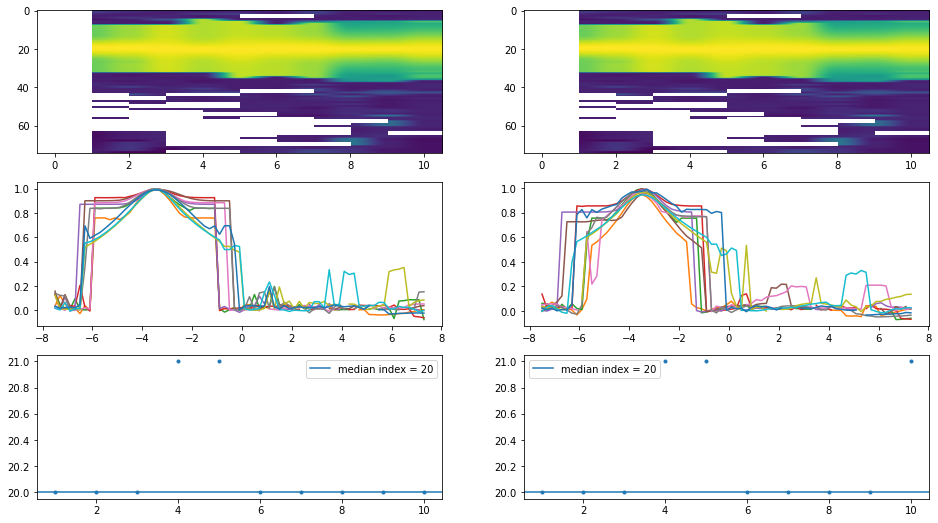

In [29]:
figure,[[ax1,ax2],[ax3,ax4],[ax5,ax6]]=subplots(nrows=3,ncols=2,figsize=(16,9))
ax1.imshow(PRarr[:,0,:],aspect='auto')
ax2.imshow(PRarr[:,0,:],aspect='auto')
ax3.plot(t_offset_range_coarse,PRarr[:,0,:])
ax4.plot(t_offset_range_coarse,PRarr[:,1,:])

PRmax=np.zeros((len(chans),len(freqs)))
for i in range(len(chans)):
    for j in range(len(freqs)):
        try:
            PRmax[i,j]=np.where(PRarr[:,i,j]==np.nanmax(PRarr[:,i,j]))[0][0]
        except IndexError:
            PRmax[i,j]=np.NAN
            
for i,ax in enumerate([ax5,ax6]):
    ax.plot(PRmax[i],'.')
    ax.axhline(int(np.nanmedian(PRmax[i])),label='median index = {}'.format(int(np.nanmedian(PRmax[i]))))
    ax.legend()


In [30]:
## Redefine time axis for fine resolution:
tfine0=t_offset_range_coarse[int(np.nanmedian(PRmax))]
t_offset_range_fine=np.arange(tfine0-0.25,tfine0+0.25,0.01)

## Define output products from fits:
AFit_f_params_fine=np.zeros((len(t_offset_range_fine),len(chans),len(freqs),5))
GFit_f_params_fine=np.zeros((len(t_offset_range_fine),len(chans),len(freqs),6))
PRarr_fine=np.zeros((len(t_offset_range_fine),len(chans),len(freqs)))

for i,ttry in enumerate(t_offset_range_fine):
    origtaxis=dronetest1022.t_arr_datetime[:]
    tempdronetest=dronetest1022
    tempdronetest.t_arr_datetime=dronetest1022.t_arr_datetime+datetime.timedelta(seconds=ttry)
    tempconcat=concat.CONCAT(CORRDATCLASS=corrtest1022,DRONEDATCLASS=tempdronetest)
    dronetest1022.t_arr_datetime=origtaxis
    for j,chan in enumerate(chans):
        for k,find in enumerate(freqs):
            try:
                ## define timecuts for amplitude:
                tacut0=tempconcat.t_index[tempconcat.V[:,find,0]<0.98*(np.nanmax(tempconcat.V[:,find,0]))]
                tacut1=tempconcat.t_index[tempconcat.V[:,find,1]<0.98*(np.nanmax(tempconcat.V[:,find,1]))]
                tacut=np.intersect1d(tacut0,tacut1)
                ## define timecuts for cartesian coordinates:
                txcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,0])<50.0]
                tycut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,1])<50.0]
                tzcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,2])>170.0]
                ttcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut),concattest1022.inds_on)
                ## data points for fit:
                mbx=tempconcat.drone_xyz_LC_interp[ttcut,0]
                mby=tempconcat.drone_xyz_LC_interp[ttcut,1]
                mbz=tempconcat.drone_xyz_LC_interp[ttcut,2]
                mbV=tempconcat.V[ttcut,find,j]
                mb_input_data=np.array([mbx,mby,mbV])
                ## shared params:
                amp0=np.nanmax(mbV)
                bg0=np.nanmin(mbV)
                x00=tempconcat.dish_coords[int(chan/2),0]
                y00=tempconcat.dish_coords[int(chan/2),1]
                ## airy params:
                rad0=25.0
                ## 2dgauss params:
                xsig0=6.0
                ysig0=6.0
                ## initial guess and bounds:
                pA=np.array([amp0,x00,y00,rad0,bg0])
                #BA=(np.array([0.0,-50.0,-50.0,0.0]),np.array([1e-6,50,50,50]))
                pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
                #BG=(np.array([0.0,-30.0,0.0,-30.0,0.0]),np.array([1e-6,30,50,30,50]))
                ## run the fits:
                #AFit_f_params_fine[i,j,k,:]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
                GFit_f_params_fine[i,j,k,:]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
                PRarr_fine[i,j,k]=pearsonr(mbV,Gauss_2d_LC_func(GFit_f_params[i,j,k,:],mbx,mby))[0]
            except ValueError:
                AFit_f_params_fine[i,j,k,:]=np.NAN*np.zeros(5)
                GFit_f_params_fine[i,j,k,:]=np.NAN*np.zeros(6)
                PRarr_fine[i,j,k]=np.NAN

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26921 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26921 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26921 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26920 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26920 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26920 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26914 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26914 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26913 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3943: PearsonRNearConstantInputWarning: An input array is nearly constant; the computed correlation coefficent may be inaccurate.
  warnings.warn(PearsonRNearConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26913 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26912 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26912 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

<ipython-input-31-85315457efc9>:11: RuntimeWarning: All-NaN slice encountered
  PRmax_fine[i,j]=np.where(PRarr_fine[:,i,j]==np.nanmax(PRarr_fine[:,i,j]))[0][0]


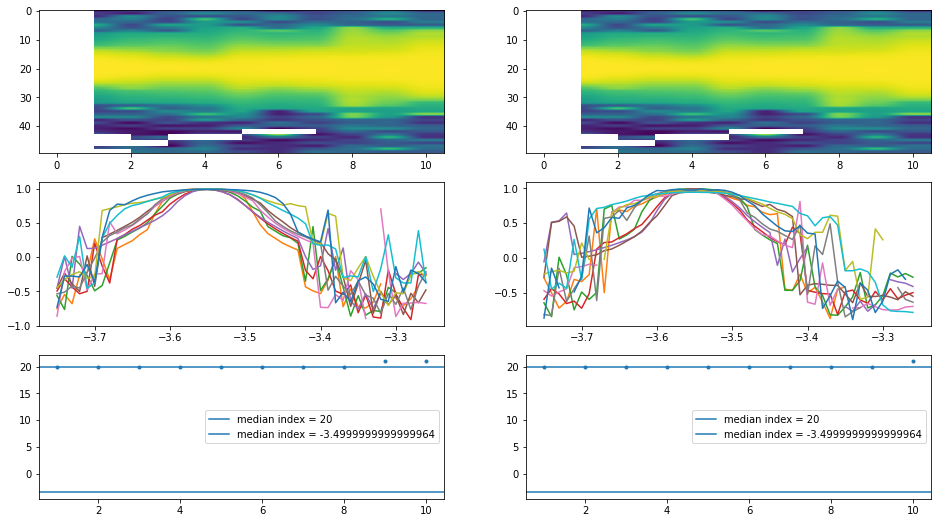

In [31]:
figure,[[ax1,ax2],[ax3,ax4],[ax5,ax6]]=subplots(nrows=3,ncols=2,figsize=(16,9))
ax1.imshow(PRarr_fine[:,0,:],aspect='auto')
ax2.imshow(PRarr_fine[:,0,:],aspect='auto')
ax3.plot(t_offset_range_fine,PRarr_fine[:,0,:])
ax4.plot(t_offset_range_fine,PRarr_fine[:,1,:])

PRmax_fine=np.zeros((len(chans),len(freqs)))
for i in range(len(chans)):
    for j in range(len(freqs)):
        try:
            PRmax_fine[i,j]=np.where(PRarr_fine[:,i,j]==np.nanmax(PRarr_fine[:,i,j]))[0][0]
        except IndexError:
            PRmax_fine[i,j]=np.NAN
                
tfinex=t_offset_range_coarse[int(np.nanmedian(PRmax))]
for i,ax in enumerate([ax5,ax6]):
    ax.plot(PRmax_fine[i],'.')
    ax.axhline(int(np.nanmedian(PRmax_fine[i])),label='median index = {}'.format(int(np.nanmedian(PRmax_fine[i]))))
    ax.axhline(tfinex,label='median index = {}'.format(tfinex))
    ax.legend()




Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26915 elements
  --> drone timestamp axis contains 11489 elements


/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]


Maximum Pearson_R Correlations:
  --> t_indices = [554. 551. 566. 566. 552. 565. 555. 554. 561. 560. 560. 561. 561.  nan
 572. 573.]
  --> t_offsets = [-0.17817818 -0.17937938 -0.17337337 -0.17337337 -0.17897898 -0.17377377
 -0.17777778 -0.17817818 -0.17537538 -0.17577578 -0.17577578 -0.17537538
 -0.17537538         nan -0.17097097 -0.17057057]
Selecting global time offset:
  --> global_t_offset = -0.1544038554
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:186: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  tight_layout()


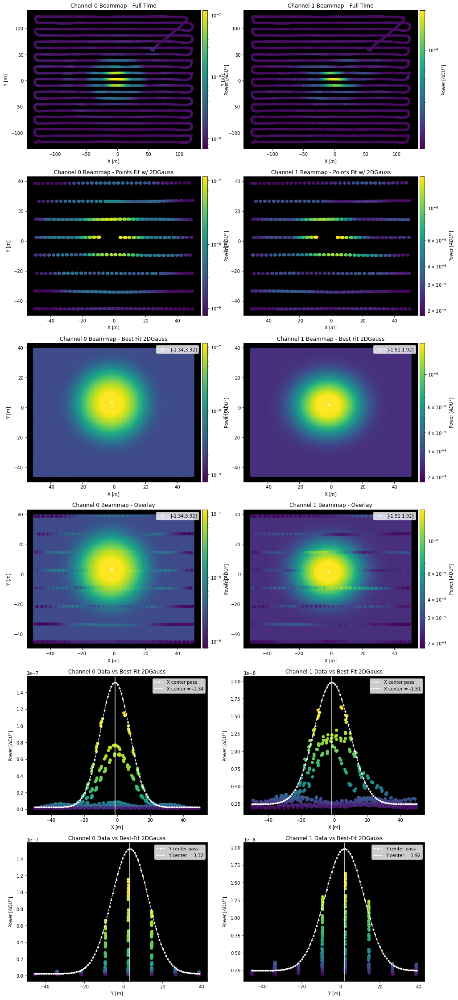

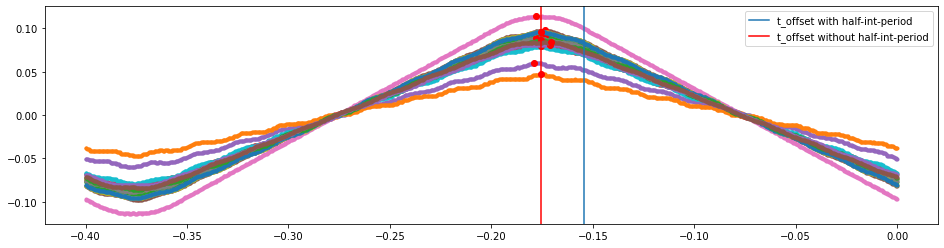

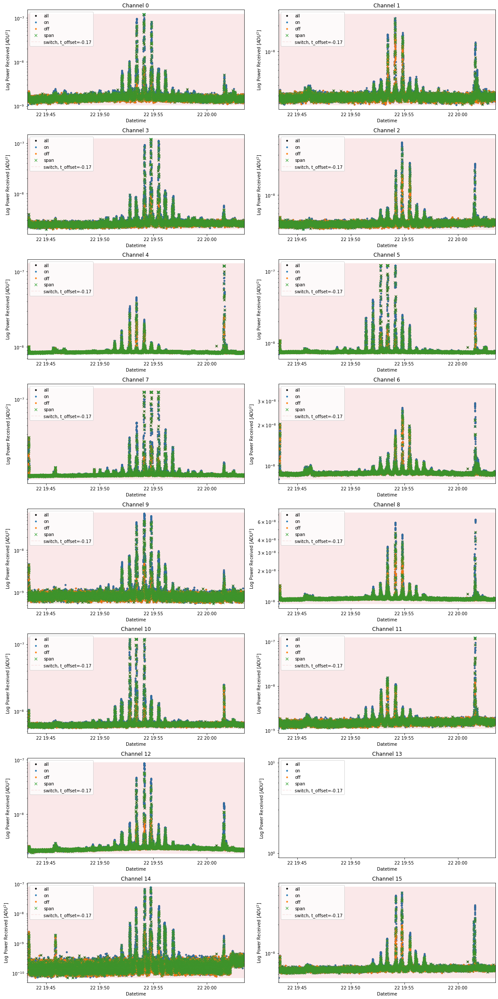

In [32]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

## Make figures for the best-fit time offset at a particular frequency:
figure,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8],[ax9,ax10],[ax11,ax12]]=subplots(nrows=6,ncols=2,figsize=(16,40))

## Make temp concat file with tfinex (best fit time offset)
origtaxis=dronetest1022.t_arr_datetime[:]
tempdronetest=dronetest1022
tempdronetest.t_arr_datetime=dronetest1022.t_arr_datetime+datetime.timedelta(seconds=tfinex)
tempconcat=concat.CONCAT(CORRDATCLASS=corrtest1022,DRONEDATCLASS=tempdronetest)
tempconcat.Extract_Source_Pulses()
tempconcat.Perform_Background_Subtraction()
dronetest1022.t_arr_datetime=origtaxis

#stop: BACKGROUND SUBTRACT FOR BETTER FITS???

find=905
for j,chan in enumerate(chans):
    ## define timecuts for amplitude:
    tacut0=tempconcat.t_index[tempconcat.V[:,find,0]<0.98*(np.nanmax(tempconcat.V[:,find,0]))]
    tacut1=tempconcat.t_index[tempconcat.V[:,find,1]<0.98*(np.nanmax(tempconcat.V[:,find,1]))]
    tacut=np.intersect1d(tacut0,tacut1)
    ## define timecuts for cartesian coordinates:
    txcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,0])<50.0]
    tycut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,1])<50.0]
    tzcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,2])>170.0]
    ttcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut),concattest1022.inds_on)
    ## data points for fit:
    mbx=tempconcat.drone_xyz_LC_interp[ttcut,0]
    mby=tempconcat.drone_xyz_LC_interp[ttcut,1]
    mbz=tempconcat.drone_xyz_LC_interp[ttcut,2]
    mbV=tempconcat.V[ttcut,find,j]
    mb_input_data=np.array([mbx,mby,mbV])
    ## shared params:
    amp0=np.nanmax(mbV)
    bg0=np.nanmin(mbV)
    x00=tempconcat.dish_coords[int(j/2),0]
    y00=tempconcat.dish_coords[int(j/2),1]
    ## airy params:
    rad0=25.0
    ## 2dgauss params:
    xsig0=6.0
    ysig0=6.0
    ## initial guess and bounds:
    pA=np.array([amp0,x00,y00,rad0,bg0])
    #BA=(np.array([0.0,-50.0,-50.0,0.0]),np.array([1e-6,50,50,50]))
    pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
    popt=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
    ## simulate space of these coords:
    simx=np.outer(np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),np.ones(100)).flatten()
    simy=np.outer(np.ones(100),np.linspace(np.nanmin(mby),np.nanmax(mby),100)).flatten()
    simV=Gauss_2d_LC_func(popt,simx,simy)
    (np.nanmin(mbx),np.nanmax(mbx),100)
    ## PLOT 1
    ax=[ax1,ax2][j]
    ax.set_title('Channel {} Beammap - Full Time'.format(j))
    ax.set_facecolor('k')
    tbig=np.intersect1d(tzcut,concattest1022.inds_on)
    im=ax.scatter(tempconcat.drone_xyz_LC_interp[tbig,0],tempconcat.drone_xyz_LC_interp[tbig,1],c=tempconcat.V[tbig,find,j],s=20,norm=LogNorm())
    #im.set_clim(np.nanmin(mbV),np.nanmax(mbV))
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=figure.colorbar(im,cax=cax)
    cbar.set_label('Power [$ADU^2$]')
    ## PLOT 1
    ax=[ax3,ax4][j]
    ax.set_title('Channel {} Beammap - Points Fit w/ 2DGauss'.format(j))
    ax.set_facecolor('k')
    im=ax.scatter(mbx,mby,c=mbV,norm=LogNorm())
    im.set_clim(np.nanmin(mbV),np.nanmax(mbV))
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=figure.colorbar(im,cax=cax)
    cbar.set_label('Power [$ADU^2$]')
    ## PLOT 2
    ax=[ax5,ax6][j]
    ax.set_title('Channel {} Beammap - Best Fit 2DGauss'.format(j))
    ax.set_facecolor('k')
    im=ax.scatter(simx,simy,c=simV,norm=LogNorm())
    im.set_clim(np.nanmin(mbV),np.nanmax(mbV))
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=figure.colorbar(im,cax=cax)
    cbar.set_label('Power [$ADU^2$]')
    ax.plot(popt[1],popt[3],'wx',label='[{:.2f},{:.2f}]'.format(popt[1],popt[3]))
    ax.legend()
    ## PLOT 3
    ax=[ax7,ax8][j]
    ax.set_title('Channel {} Beammap - Overlay'.format(j))
    ax.set_facecolor('k')
    im=ax.scatter(simx,simy,c=simV,norm=LogNorm())
    im.set_clim(np.nanmin(mbV),np.nanmax(mbV))
    im=ax.scatter(mbx,mby,c=mbV,norm=LogNorm())
    im.set_clim(np.nanmin(mbV),np.nanmax(mbV))
    divider=make_axes_locatable(ax)
    cax=divider.append_axes("right", size="3%", pad=0.05)
    cbar=figure.colorbar(im,cax=cax)
    cbar.set_label('Power [$ADU^2$]')
    ax.plot(popt[1],popt[3],'wx',label='[{:.2f},{:.2f}]'.format(popt[1],popt[3]))
    ax.legend()
    ## PLOT 4
    ax=[ax9,ax10][j]
    ax.set_title('Channel {} Data vs Best-Fit 2DGauss'.format(j))
    ax.set_facecolor('k')
    ax.scatter(mbx,mbV,c=mbV,norm=LogNorm())
    ax.plot(np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),Gauss_2d_LC_func(popt,np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),popt[3]*np.ones(100)),'w.--',label='X center pass')
    ax.axvline(popt[1],c='w',label='X center = {:.2f}'.format(popt[1]))
    ax.semilogy
    ax.legend()
    ## PLOT 4
    ax=[ax11,ax12][j]
    ax.set_title('Channel {} Data vs Best-Fit 2DGauss'.format(j))
    ax.set_facecolor('k')
    ax.scatter(mby,mbV,c=mbV,norm=LogNorm())
    ax.plot(np.linspace(np.nanmin(mby),np.nanmax(mby),100),Gauss_2d_LC_func(popt,popt[1]*np.ones(100),np.linspace(np.nanmin(mby),np.nanmax(mby),100)),'w.--',label='Y center pass')
    ax.axvline(popt[3],c='w',label='Y center = {:.2f}'.format(popt[3]))
    ax.semilogy
    ax.legend()

for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
    ax.set_xlabel('X $[m]$')
    ax.set_ylabel('Y $[m]$')
for i,ax in enumerate([ax9,ax10]):
    ax.set_xlabel('X $[m]$')
    ax.set_ylabel('Power [$ADU^2$]')
for i,ax in enumerate([ax11,ax12]):
    ax.set_xlabel('Y $[m]$')
    ax.set_ylabel('Power [$ADU^2$]')
tight_layout()


(75, 2, 11, 5)


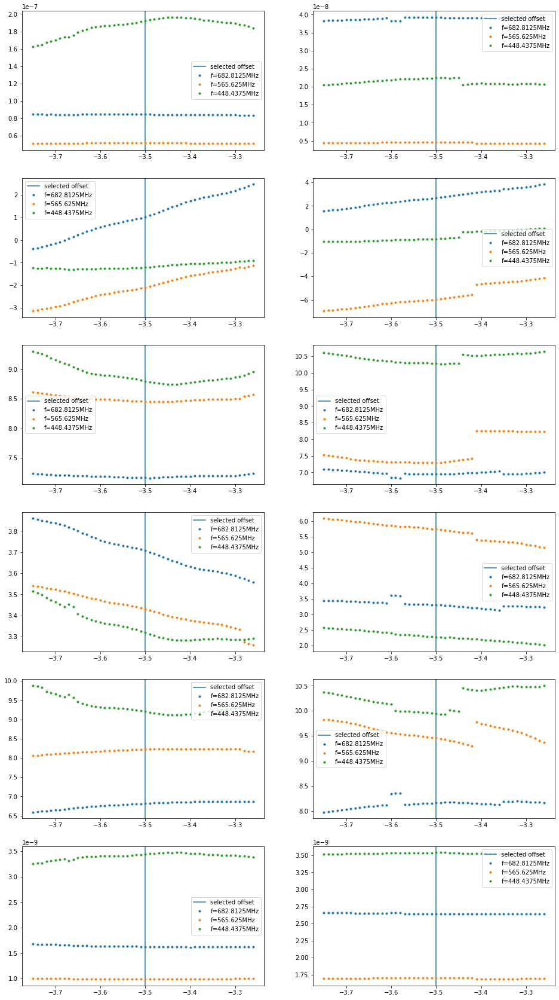

In [33]:
print(AFit_f_params.shape)
figure,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8],[ax9,ax10],[ax11,ax12]]=subplots(nrows=6,ncols=2,figsize=(16,30))

axs=[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8],[ax9,ax10],[ax11,ax12]]
GPkeys=['Amplitude','X0','Xsig','Y0','Ysig','bg0']
for i,key in enumerate(GPkeys):
    for j,chan in enumerate(chans):
        ax=axs[i][j]
        ax.axvline(tfinex,label='selected offset')
        for k in [3,6,9]:
            #ax.plot(t_offset_range_coarse,GFit_f_params[:,j,k,i],'.',label='f={}MHz'.format(tempconcat.freq[freqs[k]]))
            ax.plot(t_offset_range_fine,GFit_f_params_fine[:,j,k,i],'.',label='f={}MHz'.format(tempconcat.freq[freqs[k]]))
        ax.legend()

In [34]:
def Fit_Main_Beam(inputconcat,chans,freqs,coordbounds=[50.0,50.0,150.0],ampbound=0.98):
    A_popt=np.zeros((len(chans),len(freqs),5))
    A_PR=np.zeros((len(chans),len(freqs)))
    G_popt=np.zeros((len(chans),len(freqs),6))
    G_PR=np.zeros((len(chans),len(freqs)))
    ## define timecuts for cartesian coordinates:
    txcut=inputconcat.t_index[np.abs(inputconcat.drone_xyz_LC_interp[:,0])<coordbounds[0]]
    tycut=inputconcat.t_index[np.abs(inputconcat.drone_xyz_LC_interp[:,1])<coordbounds[1]]
    tzcut=inputconcat.t_index[np.abs(inputconcat.drone_xyz_LC_interp[:,2])>coordbounds[2]]
    for i,chan in enumerate(chans):
        for j,find in enumerate(freqs):
            ## apply amplitude cut:
            tacut=inputconcat.t_index[inputconcat.V[:,find,chan]<ampbound*(np.nanmax(inputconcat.V[:,find,chan]))]
            ttcut=np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut)
            ## pull the proper coords for fitting:
            mbx=inputconcat.drone_xyz_LC_interp[ttcut,0]
            mby=inputconcat.drone_xyz_LC_interp[ttcut,1]
            mbz=inputconcat.drone_xyz_LC_interp[ttcut,2]
            mbV=inputconcat.V[ttcut,find,chan]
            mb_input_data=np.array([mbx,mby,mbV])
            ## shared params:
            amp0=np.nanmax(mbV)
            bg0=np.nanmin(mbV)
            x00=inputconcat.dish_coords[int(chan/2),0]
            y00=inputconcat.dish_coords[int(chan/2),1]
            ## airy params:
            rad0=25.0
            ## 2dgauss params:
            xsig0=6.0
            ysig0=6.0
            ## initial guess and bounds:
            pA=np.array([amp0,x00,y00,rad0,bg0])
            pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
            ## run the fits:
            A_popt[i,j]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
            A_PR[i,j]=pearsonr(mbV,Airy_2d_LC_func(A_popt[i,j,:],mbx,mby))[0]
            G_popt[i,j]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
            G_PR[i,j]=pearsonr(mbV,Gauss_2d_LC_func(G_popt[i,j,:],mbx,mby))[0]
    return A_popt,A_PR,G_popt,G_PR
        
def Synchronization_Test_Function(inputdrone,inputcorr,inputconcat,coarse_params=[-10.0,10.0,0.2],fine_params=[-0.5,0.5,0.01],chans=np.arange(0,2),freqs=np.arange(100,1024,150)):
    ## Begin with specifying time axis for iteration:
    t_coarse=np.arange(coarse_params[0],coarse_params[1],coarse_params[2])
    ## Define output products from fits:
    AFit_f_params=np.zeros((len(t_coarse),len(chans),len(freqs),5))
    APRarr=np.zeros((len(t_coarse),len(chans),len(freqs)))
    GFit_f_params=np.zeros((len(t_coarse),len(chans),len(freqs),6))
    GPRarr=np.zeros((len(t_coarse),len(chans),len(freqs)))
    ## Begin iterative loop for coarse time axis:
    for i,ttry in enumerate(t_coarse):
        origtaxis=inputdrone.t_arr_datetime[:]
        tempdrone=inputdrone
        tempdrone.t_arr_datetime=inputdrone.t_arr_datetime+datetime.timedelta(seconds=ttry)
        tempconcat=concat.CONCAT(CORRDATCLASS=inputcorr,DRONEDATCLASS=tempdrone)
        inputdrone.t_arr_datetime=origtaxis
        ## Run fits:
        result=Fit_Main_Beam(tempconcat,chans,freqs,coordbounds=[50.0,50.0,150.0],ampbound=0.995)
        AFit_f_params[i]=result[0]
        APRarr[i]=result[3]
        GFit_f_params[i]=result[2]
        GPRarr[i]=result[3]
    ## Loop over the channels and frequencies to find the index that maximizes the Pearson R Array:
    GPRmax=np.zeros((len(chans),len(freqs)))
    for i in range(len(chans)):
        for j in range(len(freqs)):
            try:
                GPRmax[i,j]=np.where(GPRarr[:,i,j]==np.nanmax(GPRarr[:,i,j]))[0][0]
            except IndexError:
                GPRmax[i,j]=np.NAN
    ## Redefine time axis for fine resolution:
    tfine0=t_coarse[int(np.nanmedian(GPRmax))]
    t_fine=np.arange(tfine0+fine_params[0],tfine0+fine_params[1],fine_params[2])
    ## Define output products from fine resolution fits:
    AFit_f_params_fine=np.zeros((len(t_fine),len(chans),len(freqs),5))
    APRarr_fine=np.zeros((len(t_fine),len(chans),len(freqs)))
    GFit_f_params_fine=np.zeros((len(t_fine),len(chans),len(freqs),6))
    GPRarr_fine=np.zeros((len(t_fine),len(chans),len(freqs)))
    ## Begin iterative loop for coarse time axis:    
    for i,ttry in enumerate(t_fine):
        origtaxis=inputdrone.t_arr_datetime[:]
        tempdrone=inputdrone
        tempdrone.t_arr_datetime=inputdrone.t_arr_datetime+datetime.timedelta(seconds=ttry)
        tempconcat=concat.CONCAT(CORRDATCLASS=inputcorr,DRONEDATCLASS=tempdrone)
        inputdrone.t_arr_datetime=origtaxis
        ## Run fits:
        result=Fit_Main_Beam(tempconcat,chans,freqs,coordbounds=[50.0,50.0,150.0],ampbound=0.995)
        AFit_f_params_fine[i]=result[0]
        APRarr_fine[i]=result[3]
        GFit_f_params_fine[i]=result[2]
        GPRarr_fine[i]=result[3]
    ## Find the maximal Pearson R values for the fine time axis:
    GPRmax_fine=np.zeros((len(chans),len(freqs)))
    for i in range(len(chans)):
        for j in range(len(freqs)):
            try:
                GPRmax_fine[i,j]=np.where(GPRarr_fine[:,i,j]==np.nanmax(GPRarr_fine[:,i,j]))[0][0]
            except IndexError:
                GPRmax_fine[i,j]=np.NAN
    tfinex=t_fine[int(np.nanmedian(GPRmax_fine))]                
                
                
                
                
    #return AFit_f_params,APRarr,GFit_f_params,GPRarr
    #return AFit_f_params_fine,APRarr_fine,GFit_f_params_fine,GPRarr_fine
    return tfinex
                    
                    
## Read in the Drone_Data class:
#dronedir='/hirax/all_drone_data/datcon_csv/'
#dronetest0825=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY533.csv',site_class=gbosite)

#A,APR,G,GPR=Synchronization_Test_Function(inputdrone=dronetest0825,inputcorr=corrtest0825,inputconcat=concattest0825,coarse_params=[-10.0,10.0,5.0],fine_params=[-0.1,0.1,0.05],freqs=np.arange(900,905))
GPR=Synchronization_Test_Function(inputdrone=dronetest0825,inputcorr=corrtest0825,inputconcat=concattest0825,coarse_params=[-10.0,10.0,5.0],fine_params=[-0.1,0.1,0.05],freqs=np.arange(900,905))
#Fit_Main_Beam(inputconcat=concattest0825,chans=np.arange(0,2),freqs=np.arange(900,905))



Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29542 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29423 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29304 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

In [36]:
## Now trying to write a comprehensive function set for doing the above time offset corrections:

def Perform_Time_Offset_Correction(inputdrone,inputcorr,inputconcat,coarse_params=[-10.0,10.0,0.2],fine_params=[-0.5,0.5,0.01],chans=np.arange(0,2),freqs=np.arange(100,1024,150)):
    ## Begin with specifying time axis for iteration:
    t_coarse=np.arange(coarse_params[0],coarse_params[1],coarse_params[2])
    ## Define output products from fits:
    AFit_f_params=np.zeros((len(t_coarse),len(chans),len(freqs),5))
    GFit_f_params=np.zeros((len(t_coarse),len(chans),len(freqs),6))
    PRarr=np.zeros((len(t_coarse),len(chans),len(freqs)))
    ## Begin iterative loop for coarse time axis:
    for i,ttry in enumerate(t_coarse):
        origtaxis=inputdrone.t_arr_datetime[:]
        tempdrone=inputdrone
        tempdrone.t_arr_datetime=inputdrone.t_arr_datetime+datetime.timedelta(seconds=ttry)
        tempconcat=concat.CONCAT(CORRDATCLASS=inputcorr,DRONEDATCLASS=tempdrone)
        inputdrone.t_arr_datetime=origtaxis
        for j,chan in enumerate(chans):
            for k,find in enumerate(freqs):
                try:
                    ## define timecuts for amplitude:
                    tacut=tempconcat.t_index[tempconcat.V[:,find,chan]<0.999*(np.nanmax(tempconcat.V[:,find,chan]))]
                    ## define timecuts for cartesian coordinates:
                    txcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,0])<50.0]
                    tycut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,1])<50.0]
                    tzcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,2])>150.0]
                    ttcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut),inputconcat.inds_on)
                    ## data points for fit:
                    mbx=tempconcat.drone_xyz_LC_interp[ttcut,0]
                    mby=tempconcat.drone_xyz_LC_interp[ttcut,1]
                    mbz=tempconcat.drone_xyz_LC_interp[ttcut,2]
                    mbV=tempconcat.V[ttcut,find,j]
                    mb_input_data=np.array([mbx,mby,mbV])
                    ## shared params:
                    amp0=np.nanmax(mbV)
                    bg0=np.nanmin(mbV)
                    x00=tempconcat.dish_coords[int(j/2),0]
                    y00=tempconcat.dish_coords[int(j/2),1]
                    ## airy params:
                    rad0=25.0
                    ## 2dgauss params:
                    xsig0=6.0
                    ysig0=6.0
                    ## initial guess and bounds:
                    pA=np.array([amp0,x00,y00,rad0,bg0])
                    pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
                    ## run the fits:
                    AFit_f_params[i,j,k,:]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
                    GFit_f_params[i,j,k,:]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
                    PRarr[i,j,k]=pearsonr(mbV,Gauss_2d_LC_func(GFit_f_params[i,j,k,:],mbx,mby))[0]
                except ValueError:
                    AFit_f_params[i,j,k,:]=np.NAN*np.zeros(5)
                    GFit_f_params[i,j,k,:]=np.NAN*np.zeros(6)
                    PRarr[i,j,k]=np.NAN
    ## Find the maximal Pearson R values for the coarse time axis:
    PRmax=np.zeros((len(chans),len(freqs)))
    for i in range(len(chans)):
        for j in range(len(freqs)):
            try:
                PRmax[i,j]=np.where(PRarr[:,i,j]==np.nanmax(PRarr[:,i,j]))[0][0]
            except IndexError:
                PRmax[i,j]=np.NAN
    ## Redefine time axis for fine resolution:
    tfine0=t_coarse[int(np.nanmedian(PRmax))]
    t_fine=np.arange(tfine0+fine_params[0],tfine0+fine_params[1],fine_params[2])
    ## Define output products from fine resolution fits:
    AFit_f_params_fine=np.zeros((len(t_fine),len(chans),len(freqs),5))
    GFit_f_params_fine=np.zeros((len(t_fine),len(chans),len(freqs),6))
    PRarr_fine=np.zeros((len(t_fine),len(chans),len(freqs)))
    ## Begin iterative loop for coarse time axis:    
    for i,ttry in enumerate(t_fine):
        origtaxis=inputdrone.t_arr_datetime[:]
        tempdrone=inputdrone
        tempdrone.t_arr_datetime=inputdrone.t_arr_datetime+datetime.timedelta(seconds=ttry)
        tempconcat=concat.CONCAT(CORRDATCLASS=inputcorr,DRONEDATCLASS=tempdrone)
        inputdrone.t_arr_datetime=origtaxis
        for j,chan in enumerate(chans):
            for k,find in enumerate(freqs):
                try:
                    ## define timecuts for amplitude:
                    tacut=tempconcat.t_index[tempconcat.V[:,find,chan]<0.999*(np.nanmax(tempconcat.V[:,find,chan]))]
                    ## define timecuts for cartesian coordinates:
                    txcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,0])<50.0]
                    tycut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,1])<50.0]
                    tzcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,2])>150.0]
                    ttcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut),inputconcat.inds_on)
                    ## data points for fit:
                    mbx=tempconcat.drone_xyz_LC_interp[ttcut,0]
                    mby=tempconcat.drone_xyz_LC_interp[ttcut,1]
                    mbz=tempconcat.drone_xyz_LC_interp[ttcut,2]
                    mbV=tempconcat.V[ttcut,find,j]
                    mb_input_data=np.array([mbx,mby,mbV])
                    ## shared params:
                    amp0=np.nanmax(mbV)
                    bg0=np.nanmin(mbV)
                    x00=tempconcat.dish_coords[int(j/2),0]
                    y00=tempconcat.dish_coords[int(j/2),1]
                    ## airy params:
                    rad0=25.0
                    ## 2dgauss params:
                    xsig0=6.0
                    ysig0=6.0
                    ## initial guess and bounds:
                    pA=np.array([amp0,x00,y00,rad0,bg0])
                    pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
                    ## run the fits:
                    AFit_f_params_fine[i,j,k,:]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
                    GFit_f_params_fine[i,j,k,:]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
                    PRarr_fine[i,j,k]=pearsonr(mbV,Gauss_2d_LC_func(GFit_f_params_fine[i,j,k,:],mbx,mby))[0]
                except ValueError:
                    AFit_f_params_fine[i,j,k,:]=np.NAN*np.zeros(5)
                    GFit_f_params_fine[i,j,k,:]=np.NAN*np.zeros(6)
                    PRarr_fine[i,j,k]=np.NAN
    ## Find the maximal Pearson R values for the fine time axis:
    PRmax_fine=np.zeros((len(chans),len(freqs)))
    for i in range(len(chans)):
        for j in range(len(freqs)):
            try:
                PRmax_fine[i,j]=np.where(PRarr_fine[:,i,j]==np.nanmax(PRarr_fine[:,i,j]))[0][0]
            except IndexError:
                PRmax_fine[i,j]=np.NAN
    tfinex=t_fine[int(np.nanmedian(PRmax_fine))]
    ## Produce output verification plots:
    fig0,[[ax1,ax2],[ax3,ax4]]=subplots(nrows=2,ncols=2,figsize=(16,12))
    for i,ax in enumerate([ax1,ax2]):
        for k,find in enumerate(freqs):
            ax.plot(t_coarse,PRarr[:,i,k],label='{}MHz'.format(tempconcat.freq[find]))
        ax.axvline(t_coarse[int(np.nanmedian(PRmax[i]))],label='median t = {:.2f}'.format(t_coarse[int(np.nanmedian(PRmax[i]))]))
        ax.set_title('Channel {} Coarse Offset Correlation'.format(chans[i]))
        ax.set_xlabel('$\Delta$t $[sec]$')
        ax.set_ylabel('Pearson R Value')
        ax.legend()
    for i,ax in enumerate([ax3,ax4]):
        for k,find in enumerate(freqs):
            ax.plot(t_fine,PRarr_fine[:,i,k],label='{}MHz'.format(tempconcat.freq[find]))
        ax.axvline(t_fine[int(np.nanmedian(PRmax_fine[i]))],label='median t = {:.2f}'.format(t_fine[int(np.nanmedian(PRmax_fine[i]))]))
        ax.set_title('Channel {} Coarse Offset Correlation'.format(chans[i]))
        ax.set_xlabel('$\Delta$t $[sec]$')
        ax.set_ylabel('Pearson R Value')
        ax.legend()
    tight_layout()
    ## Produce additional verification plots:
    ## Make figures for the best-fit time offset at a particular frequency:
    figure,[[ax1,ax2],[ax3,ax4],[ax5,ax6],[ax7,ax8],[ax9,ax10],[ax11,ax12]]=subplots(nrows=6,ncols=2,figsize=(16,48))
    ## Make temp concat file with tfinex (best fit time offset)  
    origtaxis=inputdrone.t_arr_datetime[:]
    tempdrone=inputdrone
    tempdrone.t_arr_datetime=inputdrone.t_arr_datetime+datetime.timedelta(seconds=tfinex)
    tempconcat=concat.CONCAT(CORRDATCLASS=inputcorr,DRONEDATCLASS=tempdrone)
    tempconcat.Extract_Source_Pulses(t_bounds=[8000,12000])
    tempconcat.Perform_Background_Subtraction()
    inputdrone.t_arr_datetime=origtaxis
    ## use some frequency for verification plots: 
    find=900
    for j,chan in enumerate(chans):
        ## define timecuts for amplitude:
        tacut=tempconcat.t_index[tempconcat.V[:,find,chan]<0.999*(np.nanmax(tempconcat.V[:,find,chan]))]
        ## define timecuts for cartesian coordinates:
        txcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,0])<50.0]
        tycut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,1])<50.0]
        tzcut=tempconcat.t_index[np.abs(tempconcat.drone_xyz_LC_interp[:,2])>150.0]
        ttcut=np.intersect1d(np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut),inputconcat.inds_on)
        ## data points for fit:
        mbx=tempconcat.drone_xyz_LC_interp[ttcut,0]
        mby=tempconcat.drone_xyz_LC_interp[ttcut,1]
        mbz=tempconcat.drone_xyz_LC_interp[ttcut,2]
        mbV=tempconcat.V[ttcut,find,j]
        mb_input_data=np.array([mbx,mby,mbV])
        ## shared params:
        amp0=np.nanmax(mbV)
        bg0=np.nanmin(mbV)
        x00=tempconcat.dish_coords[int(j/2),0]
        y00=tempconcat.dish_coords[int(j/2),1]
        ## airy params:
        rad0=25.0
        ## 2dgauss params:
        xsig0=6.0
        ysig0=6.0
        ## initial guess and bounds:
        pA=np.array([amp0,x00,y00,rad0,bg0])
        pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
        ## run the fits:
        Apopt=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
        Gpopt=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
        ## simulate space of these coords:
        simx=np.outer(np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),np.ones(100)).flatten()
        simy=np.outer(np.ones(100),np.linspace(np.nanmin(mby),np.nanmax(mby),100)).flatten()
        simV=Gauss_2d_LC_func(Gpopt,simx,simy)
        ## PLOT 1
        ax=[ax1,ax2][j]
        ax.set_title('Channel {} Beammap - Full Time'.format(j))
        ax.set_facecolor('k')
        tbig=np.intersect1d(tzcut,tempconcat.inds_on)
        im=ax.scatter(tempconcat.drone_xyz_LC_interp[tbig,0],tempconcat.drone_xyz_LC_interp[tbig,1],c=tempconcat.V[tbig,find,j],s=20,norm=LogNorm())
        #im.set_clim(np.nanmin(mbV),np.nanmax(mbV))
        divider=make_axes_locatable(ax)
        cax=divider.append_axes("right", size="3%", pad=0.05)
        cbar=figure.colorbar(im,cax=cax)
        cbar.set_label('Power [$ADU^2$]')
        ## PLOT 1
        ax=[ax3,ax4][j]
        ax.set_title('Channel {} Beammap - Points Fit w/ 2DGauss'.format(j))
        ax.set_facecolor('k')
        im=ax.scatter(mbx,mby,c=mbV,norm=LogNorm())
        im.set_clim(np.nanmax((np.nanmin(simV),np.nanmin(mbV))),np.nanmax((np.nanmax(simV),np.nanmax(mbV))))
        divider=make_axes_locatable(ax)
        cax=divider.append_axes("right", size="3%", pad=0.05)
        cbar=figure.colorbar(im,cax=cax)
        cbar.set_label('Power [$ADU^2$]')
        ## PLOT 2
        ax=[ax5,ax6][j]
        ax.set_title('Channel {} Beammap - Best Fit 2DGauss'.format(j))
        ax.set_facecolor('k')
        im=ax.scatter(simx,simy,c=simV,norm=LogNorm())
        im.set_clim(np.nanmax((np.nanmin(simV),np.nanmin(mbV))),np.nanmax((np.nanmax(simV),np.nanmax(mbV))))
        divider=make_axes_locatable(ax)
        cax=divider.append_axes("right", size="3%", pad=0.05)
        cbar=figure.colorbar(im,cax=cax)
        cbar.set_label('Power [$ADU^2$]')
        ax.plot(Gpopt[1],Gpopt[3],'wx',label='[{:.2f},{:.2f}]'.format(Gpopt[1],Gpopt[3]))
        ax.legend()
        ## PLOT 3
        ax=[ax7,ax8][j]
        ax.set_title('Channel {} Beammap - Overlay'.format(j))
        ax.set_facecolor('k')
        im=ax.scatter(simx,simy,c=simV,norm=LogNorm())
        im.set_clim(np.nanmax((np.nanmin(simV),np.nanmin(mbV))),np.nanmax((np.nanmax(simV),np.nanmax(mbV))))
        im=ax.scatter(mbx,mby,c=mbV,norm=LogNorm())
        im.set_clim(np.nanmax((np.nanmin(simV),np.nanmin(mbV))),np.nanmax((np.nanmax(simV),np.nanmax(mbV))))
        divider=make_axes_locatable(ax)
        cax=divider.append_axes("right", size="3%", pad=0.05)
        cbar=figure.colorbar(im,cax=cax)
        cbar.set_label('Power [$ADU^2$]')
        ax.plot(Gpopt[1],Gpopt[3],'wx',label='[{:.2f},{:.2f}]'.format(Gpopt[1],Gpopt[3]))
        ax.legend()
        ## PLOT 4
        ax=[ax9,ax10][j]
        ax.set_title('Channel {} Data vs Best-Fit 2DGauss'.format(j))
        ax.set_facecolor('k')
        ax.scatter(mbx,mbV,c=mbV,norm=LogNorm())
        ax.plot(np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),Gauss_2d_LC_func(Gpopt,np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),Gpopt[3]*np.ones(100)),'w.--',label='X center pass 2DGauss')
        ax.plot(np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),Airy_2d_LC_func(Apopt,np.linspace(np.nanmin(mbx),np.nanmax(mbx),100),Apopt[2]*np.ones(100)),'c.--',label='X center pass Airy')
        ax.axvline(Gpopt[1],c='w',label='X center = {:.2f}'.format(Gpopt[1]))
        ax.semilogy
        ax.legend()
        ## PLOT 4
        ax=[ax11,ax12][j]
        ax.set_title('Channel {} Data vs Best-Fit 2DGauss'.format(j))
        ax.set_facecolor('k')
        ax.scatter(mby,mbV,c=mbV,norm=LogNorm())
        ax.plot(np.linspace(np.nanmin(mby),np.nanmax(mby),100),Gauss_2d_LC_func(Gpopt,Gpopt[1]*np.ones(100),np.linspace(np.nanmin(mby),np.nanmax(mby),100)),'w.--',label='Y center pass 2DGauss')
        ax.plot(np.linspace(np.nanmin(mby),np.nanmax(mby),100),Airy_2d_LC_func(Apopt,Apopt[1]*np.ones(100),np.linspace(np.nanmin(mby),np.nanmax(mby),100)),'c.--',label='Y center pass Airy')
        ax.axvline(Gpopt[3],c='w',label='Y center = {:.2f}'.format(Gpopt[3]))
        ax.semilogy
        ax.legend()
    for i,ax in enumerate([ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8]):
        ax.set_xlabel('X $[m]$')
        ax.set_ylabel('Y $[m]$')
    for i,ax in enumerate([ax9,ax10]):
        ax.set_xlabel('X $[m]$')
        ax.set_ylabel('Power [$ADU^2$]')
    for i,ax in enumerate([ax11,ax12]):
        ax.set_xlabel('Y $[m]$')
        ax.set_ylabel('Power [$ADU^2$]')
    tight_layout()
    

Initializing drone data via datcon_csv routine: FLY533.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK data contains 13308/13308 non-nan values
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29542 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29537 elements
  --> drone timestamp axis contains 13308 ele

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29418 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29413 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29408 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29289 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29284 elements
  --> drone timestamp axis contains 13308 elements


/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29280 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29275 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29270 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29151 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29146 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29141 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29347 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29346 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29346 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29340 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29340 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29340 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29334 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29334 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29333 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29327 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29327 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale_drone/corr/20210826T182915Z/
 --> FLY533.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 29327 elements
  --> drone timestamp axis contains 13308 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T182904Z_yale

/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:204: RuntimeWarning: Mean of empty slice
  self.V_bg[k,:,:]=np.nanmean(self.V[t_window,:,:],axis=0)


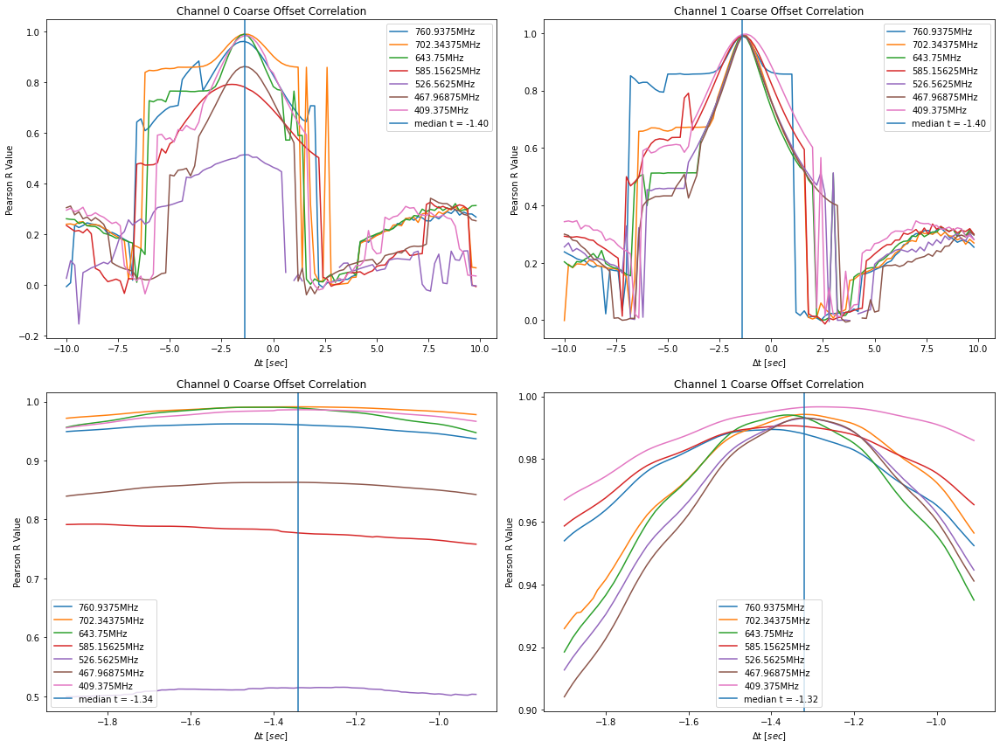

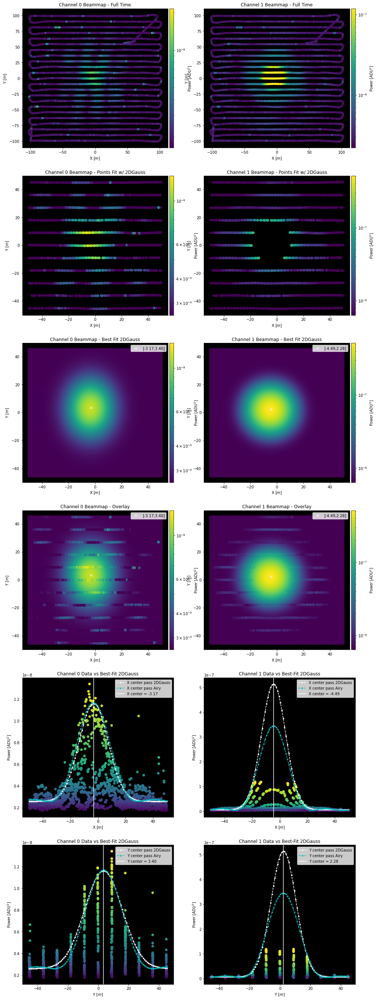

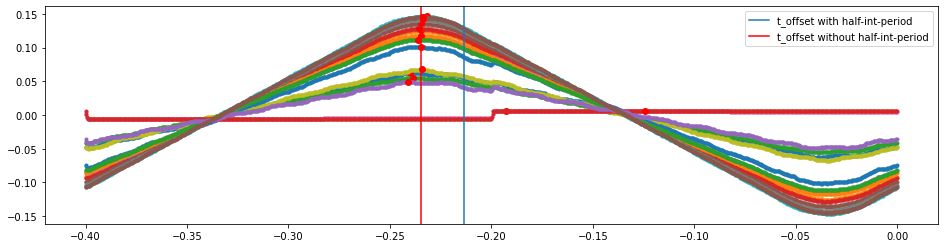

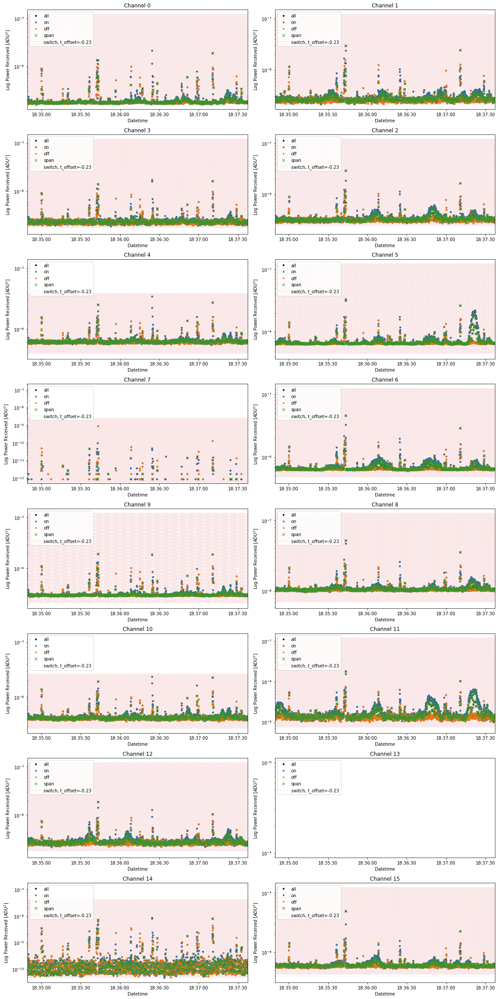

In [37]:
## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest0825=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY533.csv',site_class=gbosite)

Perform_Time_Offset_Correction(inputdrone=dronetest0825,inputcorr=corrtest0825,inputconcat=concattest0825)

Initializing drone data via datcon_csv routine: FLY534.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK data contains 12316/12316 non-nan values
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 ele

/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale_drone/corr/20210826T185632Z/
 --> FLY534.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 12316 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Aug_2021/TONE_ACQ/20210826T185621Z_yale

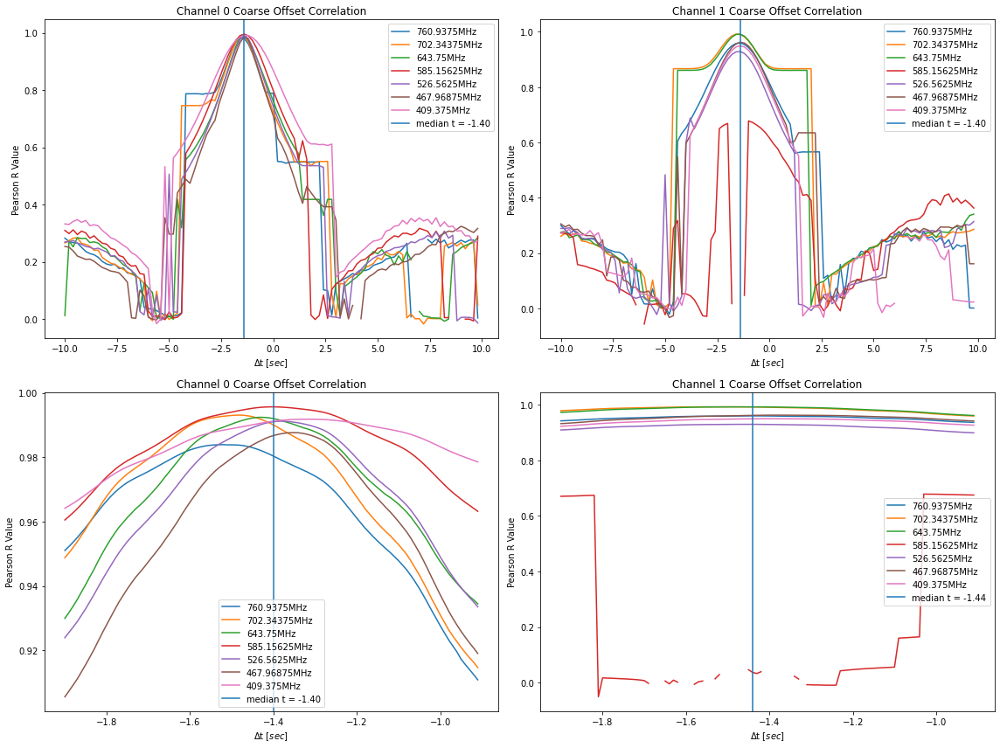

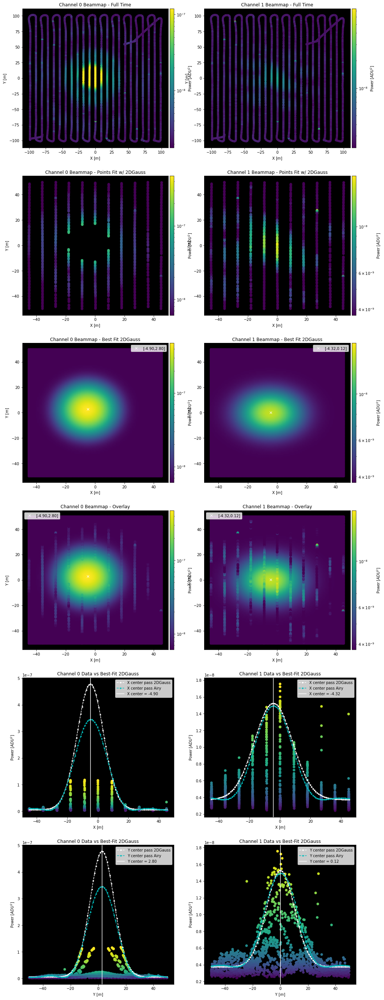

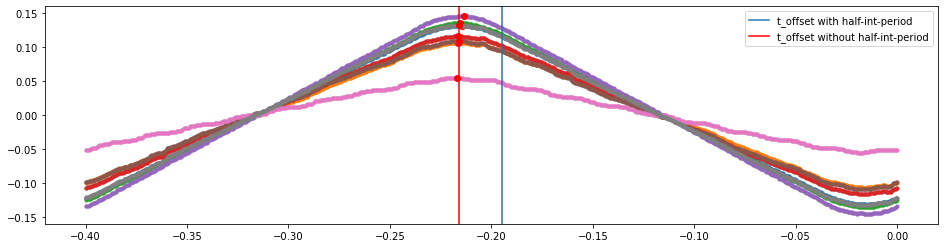

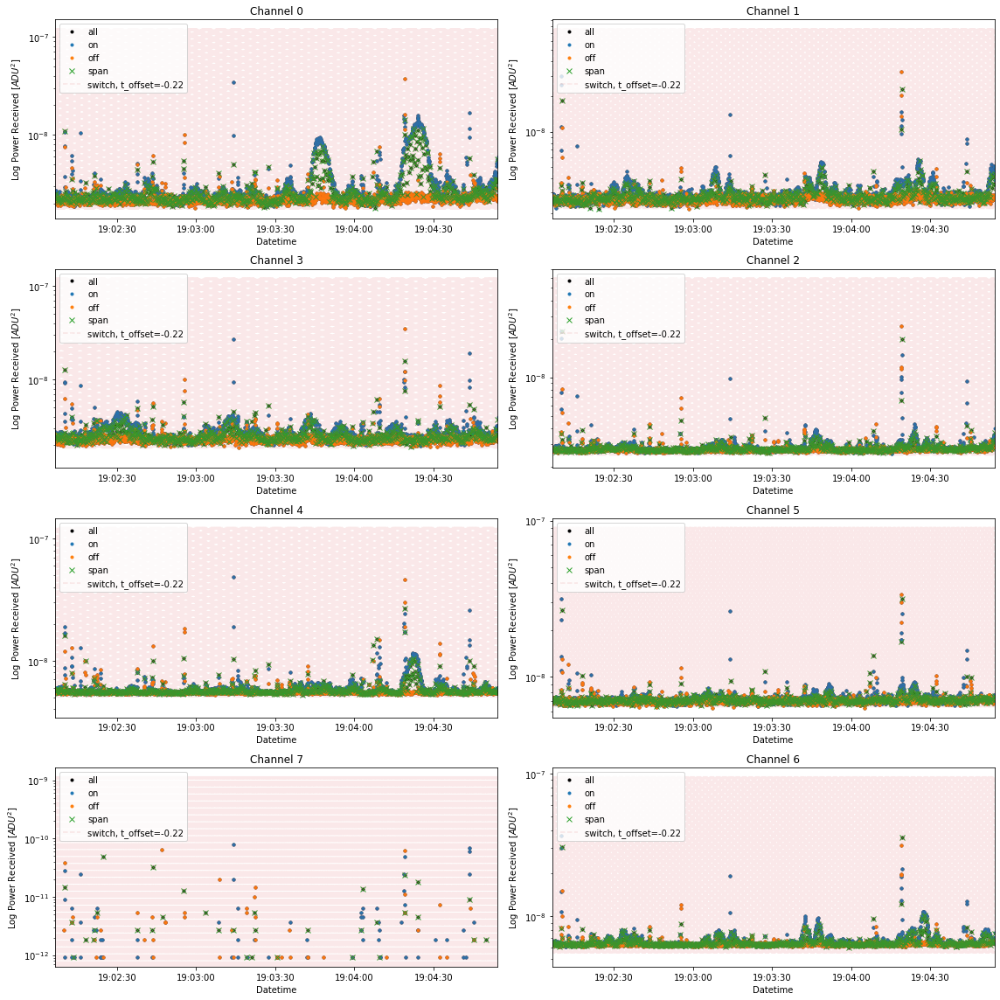

In [38]:
## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest0826=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY534.csv',site_class=gbosite)

Perform_Time_Offset_Correction(inputdrone=dronetest0826,inputcorr=corrtest0826,inputconcat=concattest0826)

Initializing drone data via datcon_csv routine: FLY613.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK data contains 0/15570 non-nan values
 ----> RTK Data not usable for this data file...
 --> Loading position data from GPS(0) instead:
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> co

/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale_drone/corr/20211021T144917Z/
 --> FLY613.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 24832 elements
  --> drone timestamp axis contains 15570 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211021T144905Z_yale

/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarnin

Maximum Pearson_R Correlations:
  --> t_indices = [ 95.  89.  89.  89.  nan  nan  99.  89.  89.  89. 112.  87.  89.  nan
 106.  91.]
  --> t_offsets = [-0.36196196 -0.36436436 -0.36436436 -0.36436436         nan         nan
 -0.36036036 -0.36436436 -0.36436436 -0.36436436 -0.35515516 -0.36516517
 -0.36436436         nan -0.35755756 -0.36356356]
Selecting global time offset:
  --> global_t_offset = -0.3433928444
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:186: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  tight_layout()


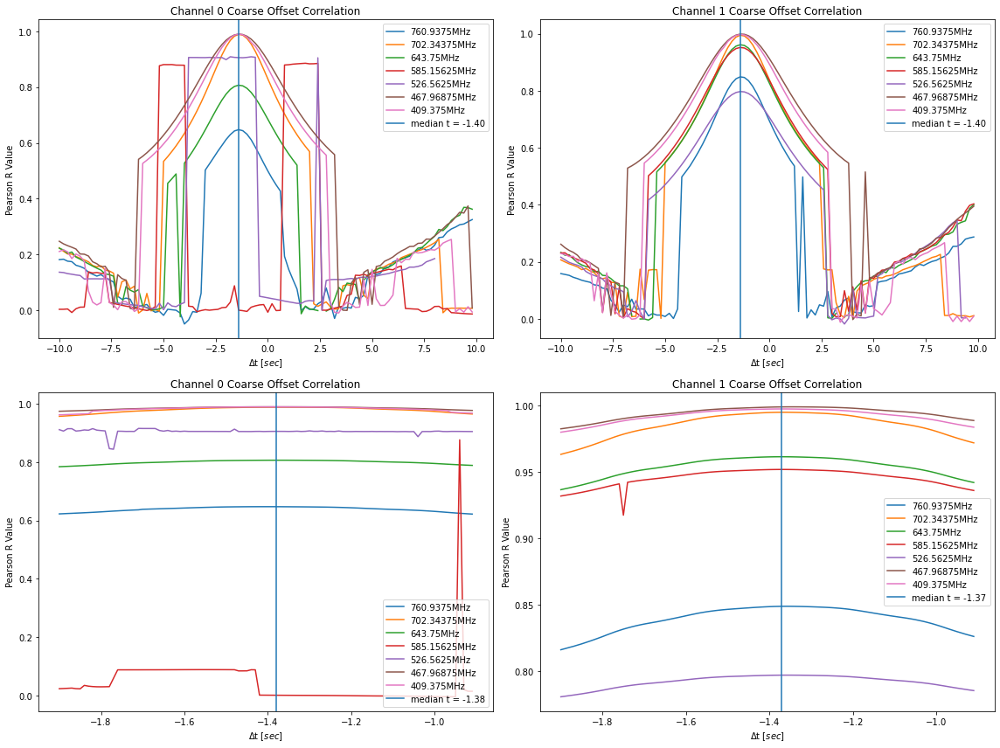

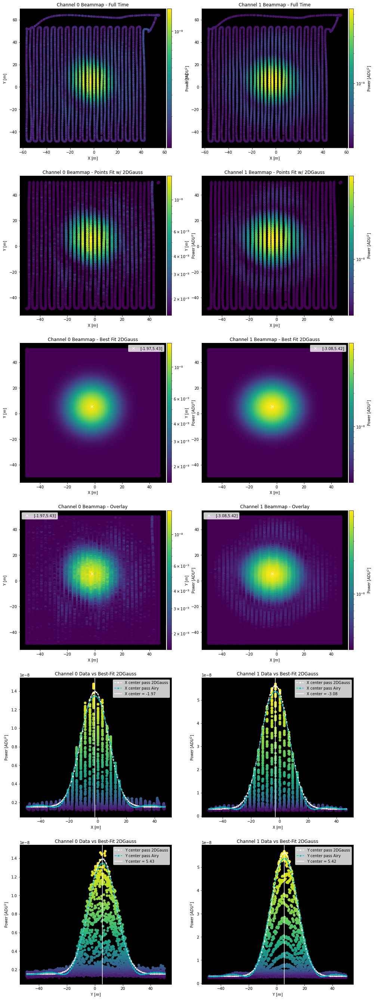

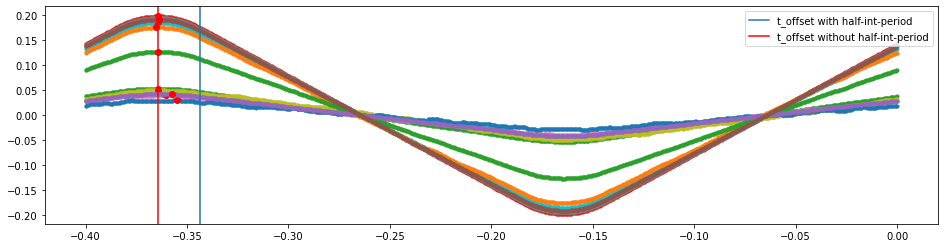

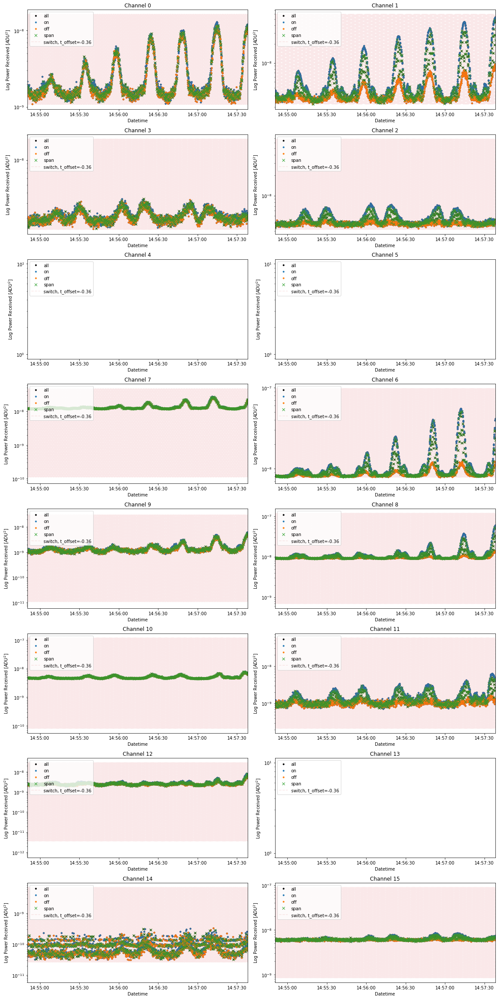

In [39]:
## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest1021=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY613.csv',site_class=gbosite)

Perform_Time_Offset_Correction(inputdrone=dronetest1021,inputcorr=corrtest1021,inputconcat=concattest1021)

Initializing drone data via datcon_csv routine: FLY649.csv
 --> Skipping rows 1 to 499 to eliminate NAN values
 --> Attempting to load position data from RTK
 ----> RTK Data not found for this data file...
 --> Loading position data from GPS(0) instead:
Timestamp interpolation succeeded
 --> generating llh, geocentric cartesian, local cartesian, and local spherical coordinates.
 --> generating dish and receiver line of sight coordinates.
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27070 elements
  --> drone timestamp axis contains 11489 elements


/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27065 elements
  --> drone timestamp axis contains 11489 elements


/home/tyndall/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3943: PearsonRNearConstantInputWarning: An input array is nearly constant; the computed correlation coefficent may be inaccurate.
  warnings.warn(PearsonRNearConstantInputWarning())


Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27061 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27056 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 27051 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26932 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26927 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26922 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26803 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26798 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26794 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26674 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26670 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26665 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26922 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26922 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26922 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26916 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26916 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26915 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26910 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26909 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26909 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26903 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26903 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale_drone/corr/20211022T194320Z/
 --> FLY649.csv
Interpolating drone coordinates for each correlator timestamp:
  --> correlator timestamp axis contains 26903 elements
  --> drone timestamp axis contains 11489 elements
Initializing CONCAT CLASS using:
 --> /hirax/GBO_Oct_2021/TONE_ACQ/20211022T194308Z_yale

/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:118: RuntimeWarning: invalid value encountered in true_divide
  normminsubdata=minsubdata/np.nanmax(minsubdata)
/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:132: RuntimeWarning: All-NaN slice encountered
  maxPrind=np.where(Pr_arr[i,:]==np.nanmax(Pr_arr[i,:]))[0][0]


Maximum Pearson_R Correlations:
  --> t_indices = [554. 551. 566. 566. 552. 565. 555. 554. 561. 560. 560. 561. 561.  nan
 572. 573.]
  --> t_offsets = [-0.17817818 -0.17937938 -0.17337337 -0.17337337 -0.17897898 -0.17377377
 -0.17777778 -0.17817818 -0.17537538 -0.17577578 -0.17577578 -0.17537538
 -0.17537538         nan -0.17097097 -0.17057057]
Selecting global time offset:
  --> global_t_offset = -0.1544038554
Finding relevant pulsing indices and checking for overlaps:
  --> on/off ind intersection: []
  --> on/span ind intersection: []
  --> off/span ind intersection: []


/home/tyndall/anaconda3/lib/python3.8/site-packages/beamcals/concat.py:186: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  tight_layout()


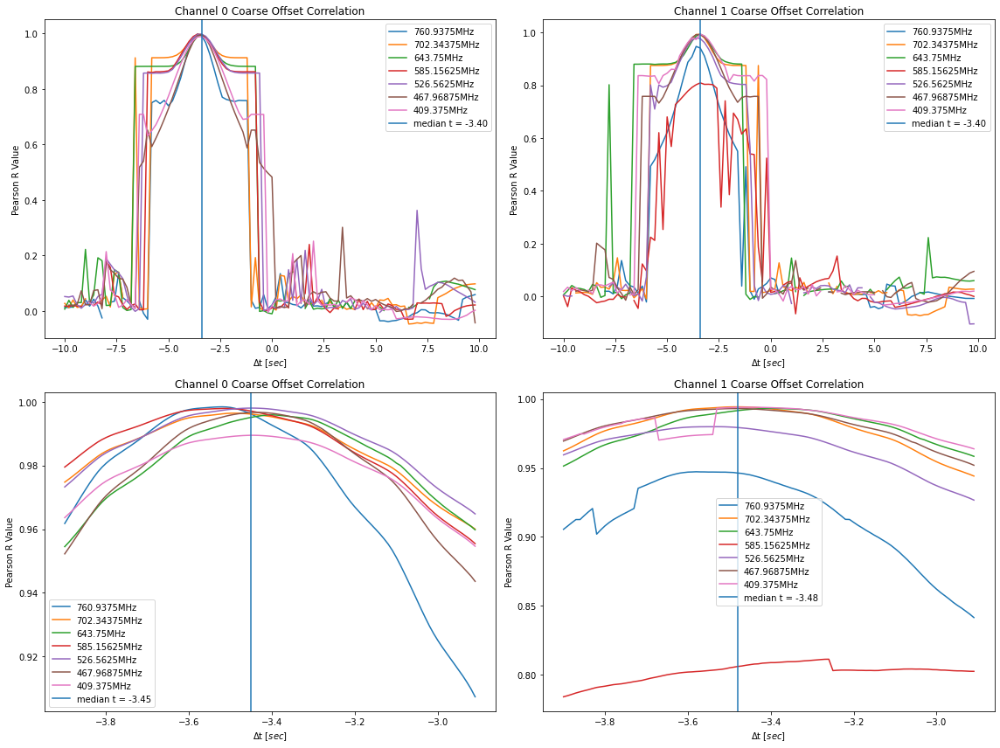

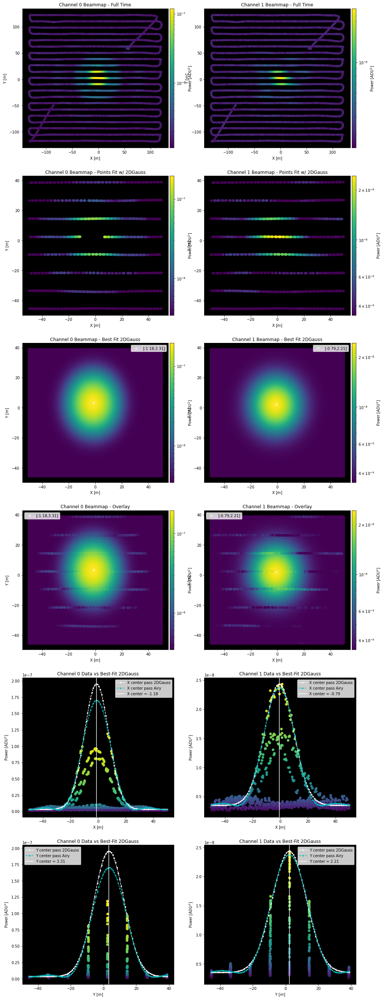

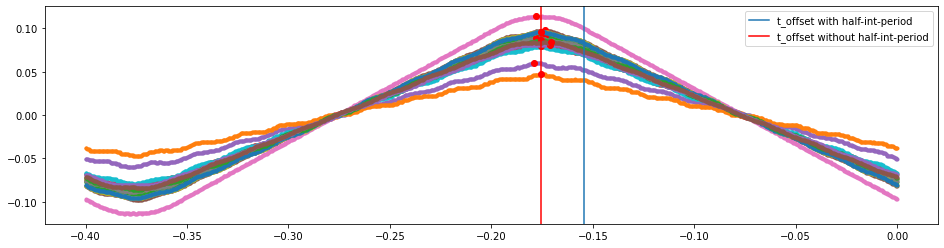

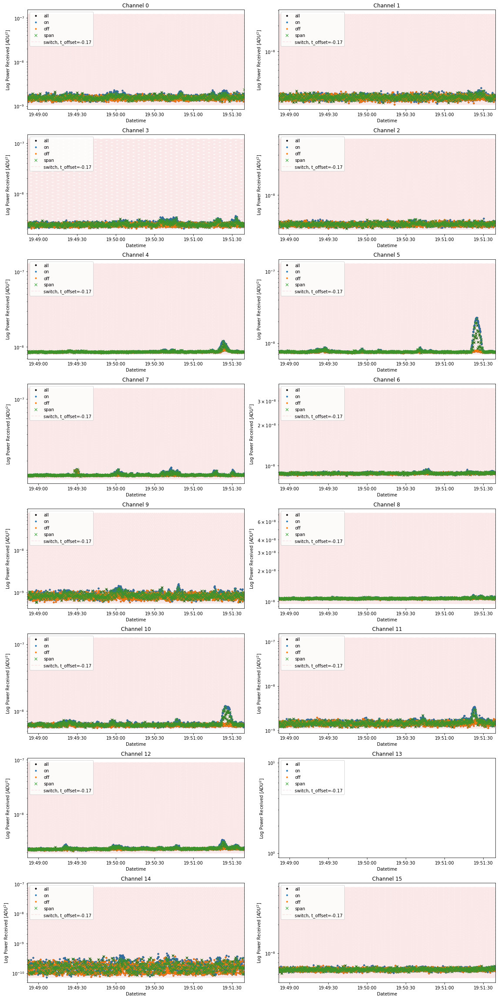

In [40]:
## Read in the Drone_Data class:
dronedir='/hirax/all_drone_data/datcon_csv/'
dronetest1022=drone.Drone_Data(Drone_Directory=dronedir,FLYTAG='FLY649.csv',site_class=gbosite)

Perform_Time_Offset_Correction(inputdrone=dronetest1022,inputcorr=corrtest1022,inputconcat=concattest1022)

In [41]:
def Fit_Main_Beam(inputconcat,chans,freqs,coordbounds=[50.0,50.0,150.0],ampbound=0.98):
    A_popt=np.zeros((len(chans),len(freqs),5))
    A_PR=np.zeros((len(chans),len(freqs)))
    G_popt=np.zeros((len(chans),len(freqs),6))
    G_PR=np.zeros((len(chans),len(freqs)))
    ## define timecuts for cartesian coordinates:
    txcut=inputconcat.t_index[np.abs(inputconcat.drone_xyz_LC_interp[:,0])<coordbounds[0]]
    tycut=inputconcat.t_index[np.abs(inputconcat.drone_xyz_LC_interp[:,1])<coordbounds[1]]
    tzcut=inputconcat.t_index[np.abs(inputconcat.drone_xyz_LC_interp[:,2])>coordbounds[2]]
    for i,chan in enumerate(chans):
        for j,find in enumerate(freqs):
            ## apply amplitude cut:
            tacut=inputconcat.t_index[inputconcat.V[:,find,chan]<ampbound*(np.nanmax(inputconcat.V[:,find,chan]))]
            ttcut=np.intersect1d(np.intersect1d(np.intersect1d(txcut,tycut),tzcut),tacut)
            ## pull the proper coords for fitting:
            mbx=inputconcat.drone_xyz_LC_interp[ttcut,0]
            mby=inputconcat.drone_xyz_LC_interp[ttcut,1]
            mbz=inputconcat.drone_xyz_LC_interp[ttcut,2]
            mbV=inputconcat.V_bgsub[ttcut,find,chan]
            mb_input_data=np.array([mbx,mby,mbV])
            ## shared params:
            amp0=np.nanmax(mbV)
            bg0=np.nanmin(mbV)
            x00=inputconcat.dish_coords[int(chan/2),0]
            y00=inputconcat.dish_coords[int(chan/2),1]
            ## airy params:
            rad0=25.0
            ## 2dgauss params:
            xsig0=6.0
            ysig0=6.0
            ## initial guess and bounds:
            pA=np.array([amp0,x00,y00,rad0,bg0])
            pG=np.array([amp0,x00,xsig0,y00,ysig0,bg0])
            ## run the fits:
            A_popt[i,j,:]=least_squares(Airy_2d_LC_opt,x0=pA,args=mb_input_data).x
            A_PR[i,j]=pearsonr(mbV,Airy_2d_LC_func(A_popt[i,j,:],mbx,mby))[0]
            G_popt[i,j,:]=least_squares(Gauss_2d_LC_opt,x0=pG,args=mb_input_data).x
            G_PR[i,j]=pearsonr(mbV,Gauss_2d_LC_func(G_popt[i,j,:],mbx,mby))[0]
            return A_popt,A_PR,G_popt,G_PR
        
Fit_Main_Beam(concattest0825,chans=[0],freqs=[900],coordbounds=[50.0,50.0,150.0],ampbound=0.98)


(array([[[1.10598008e-08, 5.66031285e+00, 3.56945789e+00, 3.85640407e+00,
          4.16639966e-10]]]),
 array([[-0.01147021]]),
 array([[[-4.17922340e-10,  1.21355805e+01,  9.72606383e+00,
           4.48101677e-01, -1.63524979e+00,  4.26758081e-10]]]),
 array([[0.0870744]]))

In [42]:
## We want to know why the drone and corr data sets are offset by ~0.7 seconds each time as shown above...
    ## Let's examine the ways that both time objects are imported/created and find the bug...

In [43]:
## Let's import the drone data and pull the timestamps using annie's interp_time function:
import pandas
dronefileraw=pandas.read_csv(dronetest.Drone_Directory+dronetest.FLYTAG,skiprows=np.arange(1,500).tolist(),low_memory=False)

NameError: name 'dronetest' is not defined

In [ ]:
# In the raw drone files, the data comes in as some GPS timestamp string with accuracy good to 1sec
rawdronetimeold=dronefileraw["GPS:dateTimeStamp"]
print(rawdronetimeold[:10])

In [ ]:
# Annie's interp_time function takes these and uses pandas to make them pandas datetimes w/ more accuracy 0.1s?
rawdronetime=np.array(tu.interp_time(dronefileraw)["UTC"],dtype='object')
print(rawdronetime[:10])

In [ ]:
z=1400
print(rawdronetimeold[z])
print(rawdronetime[z])
print(rawdronetime[z].timestamp())
print(np.datetime64(rawdronetime[z]))
print(np.datetime64(rawdronetime[z]).astype(int)*1e-6)
print(np.datetime64(rawdronetime[z]).astype(datetime.datetime))
print((np.datetime64(rawdronetime[z]).astype(datetime.datetime)-epoch).total_seconds())

tt0=np.array([z.timestamp() for z in rawdronetime])
tt1=np.array([np.datetime64(z).astype(int)*1e-6 for z in rawdronetime])
tt2=np.array([(np.datetime64(z).astype(datetime.datetime)-epoch).total_seconds() for z in rawdronetime])

fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
print(np.nanmean(tt0-tt1),np.nanmean(tt0-tt2),np.nanmean(tt1-tt2))
ax1.plot(tt0[:20],'.')
ax1.plot(tt1[:20],'.')
ax1.plot(tt2[:20],'.')

ax2.plot(tt0-tt1,'.')
ax2.plot(tt0-tt2,'.')
ax2.plot(tt1-tt2,'.')

In [ ]:
rawdronetime[:10]
rawdronetimef64=np.array([np.datetime64(i).astype(datetime.datetime) for i in rawdronetime[:10]])


In [ ]:
# However, these are shifted by annie's function as well that tries to match them to Ublox timestamps:
#np.datetime64(rawdronetime[0]).astype(datetime.datetime)

# To convert to a float comparable to the irigbtime array from the correlator, we need to subtract the epoch:
epoch=datetime.datetime.utcfromtimestamp(0)
rawdronetimef64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetime])
rawdronetimeoldf64=np.array([(np.datetime64(i).astype(datetime.datetime)-epoch).total_seconds() for i in rawdronetimeold])

print(rawdronetimef64[:4])
print(rawdronetimeoldf64[:4])
x=3852
plot(rawdronetimef64[:100],'.',label='annie shifted')
plot(rawdronetimeoldf64[:100],'.',label='raw timestamps')
legend()
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:250])
#plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:250])

In [ ]:
x=3852
plot(np.diff(rawdronetimef64[x:x+100]),'.',label='annie shifted')
plot(np.diff(rawdronetimeoldf64[x:x+100]),'.',label='raw timestamps')
legend()

In [ ]:
plot(rawdronetimef64[:]-rawdronetimeoldf64[:],'.',label='annie shifted - raw timestamps')
meantdiff=np.nanmean(rawdronetimef64[:]-rawdronetimeoldf64[:])
print(meantdiff)
axhline(meantdiff,c='r',label='mean t correction')
legend()

In [ ]:
epoch=datetime.datetime.utcfromtimestamp(0)
plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in rawcorrtime][:10],label='raw naive')
plot([(i.replace(tzinfo=None)-epoch).total_seconds() for i in corrtest.t_arr_datetime][:10],label='class naive')

epoch=datetime.datetime.utcfromtimestamp(0).replace(tzinfo=pytz.UTC)
plot([(i-epoch).total_seconds() for i in rawcorrtime][:10],'gx',label='raw naive')
plot([(i-epoch).total_seconds() for i in corrtest.t_arr_datetime][:10],'b.',label='class naive')


In [ ]:
tstep=(concattest.t_arr_datetime[1]-concattest.t_arr_datetime[0]).total_seconds()
numstepsoff=np.nanmean(meantdiff)/tstep
print(numstepsoff)

In [ ]:
for i,x in enumerate(((0,1,2),)):
    print(i,x)

In [ ]:
from matplotlib.colors import LogNorm
figure,ax=subplots(nrows=1,ncols=1,figsize=(10,10))
x=33
ax.set_facecolor('k')
ax.scatter(concattest.drone_xyz_LC_interp[x:,0],concattest.drone_xyz_LC_interp[x:,1],c=concattest.V[:-x,900,0],norm=LogNorm())
print('Applied offset is {} seconds'.format(tstep*x))

In [ ]:
## Compare all timestamps with a plot:
figure(figsize=(10,8))
plot(dronetest.t_arr_datetime[:100],'bx')
plot(corrtest.t_arr_datetime[:100],'bx')
plot(rawdronetime[:100],'r.')
plot(rawcorrtime[:100],'r.')


In [ ]:
rawcorrtime=np.array([datetime.datetime.fromtimestamp(1e-9*tt,pytz.timezone('UTC')).astimezone(pytz.utc) for tt in t_arr_irigb])

In [ ]:
fullc=np.zeros((len(concattest.filenames),256))
fullirigb=np.zeros((len(concattest.filenames),256))

for i,fn in enumerate(concattest.filenames):
    fd=h5py.File(concattest.Data_Directory+fn,'r')
    fullc[i]=np.array(fd['index_map']['time']['ctime']).astype(np.float64)
    fullirigb[i]=1e-9*np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)
    
fullc=fullc.flatten()
fullirigb=fullirigb.flatten()
t_arr_irigb=np.array(fd['index_map']['time']['irigb_time']).astype(np.float64)

In [ ]:
fd['index_map']['time'][:10]

In [ ]:
plot(np.diff(fd['index_map']['time']['ctime']),'.')
plot(np.diff(fd['index_map']['time']['irigb_time'])*1e-9,'.')

In [ ]:
fig,[ax1,ax2]=subplots(nrows=1,ncols=2,figsize=(16,6))
ax1.plot(fullirigb,'.',label='irigbtime')
ax1.plot(fullc,'.',label='ctime')
ax1.set_ylabel('t $[sec]$')
ax1.legend()

ax2.plot(fullc-fullirigb,'.',label='ctime minus irigbtime')
ax2.axhline(np.nanmean(fullc-fullirigb),c='r',label='mean difference = {}'.format(np.nanmean(fullc-fullirigb)))
ax2.set_ylabel('t difference $[sec]$')
ax2.legend()

In [ ]:
axvline(0.0)
axvline(2.4322)
axvline(1.63577)
axvline(0.32)

In [ ]:
(1e-9*t_arr_irigb[0])-(np.datetime64(rawdronetime[0]).astype(datetime.datetime)-epoch).total_seconds()

In [ ]:
datetime.datetime.now(datetime.timezone.utc).timestamp()

In [ ]:
print(t_arr_irigb[0]*1e-9)
print(datetime.datetime.now(datetime.timezone.utc).timestamp())

In [ ]:
(1e-9*t_arr_irigb)